# Bankruptcy Model

Cristian Castro

*Winter Semester 2021/2022*

In [1]:
# Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
pd.options.mode.chained_assignment = None
from scipy import stats

## Data Exploration

In [2]:
# Dataset
df_orig = pd.read_csv("/Users/cristiancastro/Desktop/Projects/BankruptcyAnalysis_MLProject/project-data/bankruptcy.csv")
df_orig.head()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,...,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
0,0.174190,0.41299,0.14371,1.3480,-28.9820,0.60383,0.219460,1.1225,1.1961,0.46359,...,0.163960,0.375740,0.83604,0.000007,9.7145,6.2813,84.291,4.3303,4.0341,b'0'
1,0.146240,0.46038,0.28230,1.6294,2.5952,0.00000,0.171850,1.1721,1.6018,0.53962,...,0.027516,0.271000,0.90108,0.000000,5.9882,4.1103,102.190,3.5716,5.9500,b'0'
2,0.000595,0.22612,0.48839,3.1599,84.8740,0.19114,0.004572,2.9881,1.0077,0.67566,...,0.007639,0.000881,0.99236,0.000000,6.7742,3.7922,64.846,5.6287,4.4581,b'0'
3,0.024526,0.43236,0.27546,1.7833,-10.1050,0.56944,0.024526,1.3057,1.0509,0.56453,...,0.048398,0.043445,0.95160,0.142980,4.2286,5.0528,98.783,3.6950,3.4844,b'0'
4,0.188290,0.41504,0.34231,1.9279,-58.2740,0.00000,0.233580,1.4094,1.3393,0.58496,...,0.176480,0.321880,0.82635,0.073039,2.5912,7.0756,100.540,3.6303,4.6375,b'0'


In [3]:
df_orig.tail()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,...,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
10498,0.002861,0.58067,-0.223860,0.51658,-31.866,0.002861,0.002861,0.618550,1.01200,0.359170,...,0.011834,0.007966,0.98817,0.32736,38.1420,39.1500,42.202,8.6489,5.2646,b'1'
10499,-0.051968,0.55254,0.147150,2.16980,12.748,-0.051968,-0.034361,0.669830,0.94694,0.370110,...,-0.056037,-0.140410,1.05600,1.15300,14.4930,9.2851,32.761,11.1410,1.9276,b'1'
10500,-0.135900,0.83954,-0.342010,0.46526,-145.310,-0.219120,-0.131860,0.191130,1.09990,0.160460,...,0.144120,-0.846930,0.85427,0.81420,6.2737,9.6966,212.230,1.7198,1.5659,b'1'
10501,0.009423,0.50028,0.261630,1.52300,-10.158,0.009423,0.007700,0.989900,1.01230,0.495230,...,0.012186,0.019027,0.98781,0.00000,5.9675,4.3536,98.240,3.7154,7.8068,b'1'
10502,-0.001775,0.94780,0.003729,1.00450,-50.221,0.000000,0.002565,0.055122,2.12680,0.052245,...,0.023492,-0.033971,0.97208,2.39850,7.5512,3.9960,141.160,2.5857,12.2250,b'1'


In [4]:
# Display all rows, all columns when exploring
pd.set_option("display.max_rows",None)
pd.set_option("display.max_columns",None)

In [5]:
# Working Dataframe and types
df = df_orig.copy(deep=True)
df.dtypes

Attr1     float64
Attr2     float64
Attr3     float64
Attr4     float64
Attr5     float64
Attr6     float64
Attr7     float64
Attr8     float64
Attr9     float64
Attr10    float64
Attr11    float64
Attr12    float64
Attr13    float64
Attr14    float64
Attr15    float64
Attr16    float64
Attr17    float64
Attr18    float64
Attr19    float64
Attr20    float64
Attr21    float64
Attr22    float64
Attr23    float64
Attr24    float64
Attr25    float64
Attr26    float64
Attr27    float64
Attr28    float64
Attr29    float64
Attr30    float64
Attr31    float64
Attr32    float64
Attr33    float64
Attr34    float64
Attr35    float64
Attr36    float64
Attr37    float64
Attr38    float64
Attr39    float64
Attr40    float64
Attr41    float64
Attr42    float64
Attr43    float64
Attr44    float64
Attr45    float64
Attr46    float64
Attr47    float64
Attr48    float64
Attr49    float64
Attr50    float64
Attr51    float64
Attr52    float64
Attr53    float64
Attr54    float64
Attr55    float64
Attr56    

In [6]:
# Descriptive Statistics
df.describe()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr37,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,10503.000000,10503.000000,10503.000000,10485.000000,1.047800e+04,10503.000000,10503.000000,10489.000000,10500.000000,10503.000000,10503.000000,10485.000000,10460.000000,10503.000000,1.049500e+04,10489.000000,10489.000000,10503.000000,10460.000000,10460.000000,9696.000000,10503.000000,10460.000000,10276.000000,10503.000000,10489.000000,9.788000e+03,10275.000000,10503.000000,10460.000000,10460.000000,1.040200e+04,10485.000000,10489.000000,10503.000000,10503.000000,5767.000000,10503.000000,10460.000000,10485.000000,10301.000000,10460.000000,10460.000000,10460.000000,9912.000000,10485.000000,1.041700e+04,10503.000000,10460.000000,10489.000000,10503.000000,10417.000000,10275.000000,10275.000000,1.050300e+04,10460.000000,10503.000000,10474.000000,10503.000000,9.911000e+03,10486.000000,1.046000e+04,10485.000000,10275.000000
mean,0.052844,0.619911,0.095490,9.980499,-1.347662e+03,-0.121159,0.065624,19.140113,1.819254,0.366093,0.086764,2.411266,0.376563,0.065634,3.004332e+03,2.729654,20.511539,0.070739,-0.170778,68.448531,4.670725,0.075676,-0.176466,0.211936,0.196153,2.580730,1.185945e+03,6.092884,3.921179,0.459346,-0.177084,1.171670e+03,8.419887,5.398356,0.071075,1.981250,102.697692,0.465510,-0.076355,2.381026,28.707178,-0.141671,195.389286,126.940260,17.451297,8.978029,5.424888e+02,0.004834,-0.217844,8.686024,0.497135,11.244158,5.725829,6.708568,6.638549e+03,-0.530082,-0.014817,3.848794,1.429319,5.713363e+02,13.935361,1.355370e+02,9.095149,35.766800
std,0.647797,6.427041,6.420056,523.691951,1.185806e+05,6.970625,0.651152,717.756745,7.581659,6.428603,0.655407,111.459642,49.675550,0.651151,1.091981e+05,110.233475,721.812766,0.835328,11.210201,1083.699904,305.897238,0.581734,11.149274,2.093845,6.742161,108.823993,3.469123e+04,94.713753,0.840528,71.755042,11.157003,6.841270e+04,37.696764,69.035263,0.572124,2.630705,2469.447679,6.425362,8.079334,37.819839,2845.290346,10.787555,3303.309554,2766.505503,1720.342176,523.565601,3.126416e+04,0.629770,11.910935,522.528325,6.420885,851.867915,89.708042,93.511530,5.989196e+04,55.978608,18.684047,190.201224,77.273270,3.715967e+04,83.704103,2.599116e+04,31.419096,428.298315
min,-17.692000,0.000000,-479.730000,0.002080,-1.190300e+07,-508.120000,-17.692000,-2.081800,-1.215700,-479.730000,-17.692000,-1543.800000,-631.710000,-17.692000,-2.321800e+06,-204.300000,-0.043411,-17.692000,-771.650000,-0.001439,-1.107500,-17.692000,-771.650000,-60.742000,-500.750000,-204.300000,-1.901300e+05,-690.400000,-0.358530,-6351.700000,-771.390000,-9.295600e+03,-1.921900,-1696.000000,-17.073000,-0.000084,-2.200900,-479.730000,-551.110000,-7.081900,-667.730000,-765.800000,-25113.000000,-25113.000000,-74385.000000,-6.469200,-1.730300e+01,-17.692000,-905.750000,0.002080,0.000000,-25.467000,-869.040000,-706.490000,-7.513800e+05,-5691.700000,-1667.300000,-198.690000,-172.070000,0.000000e+00,-6.590300,-2.336500e+06,-0.000156,-0.000102
25%,0.000686,0.253955,0.017461,1.040100,-5.207075e+01,0.000000,0.002118,0.431270,1.011275,0.297340,0.009809,0.006183,0.020740,0.002131,1.865950e+02,0.060302,1.449200,0.002131,0.001648,14.253750,0.796673,0.000000,0.000556,0.014938,0.135695,0.055067,0.000000e+00,0.027178,3.393200,0.073850,0.004012,4.471900e+01,2.785900,0.367460,0.001730,1.043500,1.038600,0.426810,0.001557,0.053666,0.022026,0.000000,65.627250,34.214750,0.006157,0.602830,1.494100e+01,-0.048988,-0.036186,0.749370,0.177200,0.122470,0.667285,0.950435,1.462100e+01,0.005137,0.006796,0.875560,0.000000,5.533150e+00,4.486075,4.073700e+01,3.062800,2.023350
50%,0.043034,0.464140,0.198560,1.605600,1.579300e+

In [7]:
# Check for NaN
df[df.isna().any(axis=1)]

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr37,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
1,0.146240,0.460380,0.282300,1.629400,2.595200e+00,0.000000e+00,0.171850,1.172100,1.601800,0.539620,0.175790,0.383170,0.126470,0.171850,8.294600e+02,0.440040,2.172100,0.171850,0.107280,60.954000,5.088900,0.175710,0.091295,NaN,0.175230,0.384420,4.459300e+01,1.048600,4.079200,0.243840,0.109740,1.050900e+02,3.473300,3.383600,4.407600e-02,1.601800,NaN,0.539620,2.751600e-02,1.640600e-01,0.074333,0.109690,149.75000,88.801000,0.546690,1.033000,6.267800e+01,0.144970,0.090503,1.587400,0.448490,0.287910,2.004400,2.004400,3.387800e+03,0.027516,0.271000,9.010800e-01,0.000000,5.988200e+00,4.110300,1.021900e+02,3.571600,5.950000,b'0'
2,0.000595,0.226120,0.488390,3.159900,8.487400e+01,1.911400e-01,0.004572,2.988100,1.007700,0.675660,0.004572,0.020219,0.030966,0.004572,2.094100e+03,0.174300,4.422500,0.004572,0.003592,53.881000,0.674510,0.040610,0.000468,0.234700,0.675660,0.156720,3.215300e-01,1.710700,4.622000,0.036196,0.003592,6.534500e+01,5.585700,0.179600,4.061000e-02,1.342500,NaN,0.675660,3.190700e-02,8.446900e-01,0.098528,0.031907,150.13000,96.251000,0.003168,2.329000,5.429600e+01,0.005769,0.004533,3.159900,0.226120,0.179030,2.366700,2.366700,2.045300e+04,0.007639,0.000881,9.923600e-01,0.000000,6.774200e+00,3.792200,6.484600e+01,5.628700,4.458100,b'0'
5,0.182060,0.556150,0.321910,1.604500,1.631400e+01,0.000000e+00,0.182060,0.798080,1.812600,0.443850,0.207660,0.341880,0.271630,0.182060,4.123000e+02,0.885280,1.798100,0.182060,0.100450,43.168000,1.272400,0.000000,0.100450,NaN,0.416000,0.885280,0.000000e+00,2.211800,3.810400,0.299260,0.228770,2.414100e+02,1.512000,1.447800,2.953800e-02,1.812600,49.017000,0.456910,1.629600e-02,1.856000e-01,0.059746,0.000000,152.16000,108.990000,0.849300,1.201900,9.717700e+01,-0.310280,-0.171190,1.536400,0.532540,0.661400,3.049600,3.139300,2.080600e+03,0.555770,0.410190,4.695700e-01,0.029421,8.455300e+00,3.348800,1.072400e+02,3.403600,12.454000,b'0'
8,0.238950,0.554730,0.406970,1.760900,-2.290700e+01,0.000000e+00,0.297140,0.802680,2.331700,0.445270,0.330610,0.555530,0.131980,0.297140,6.579500e+02,0.554750,1.802700,0.297140,0.127430,81.972000,1.046700,0.330150,0.102480,NaN,0.439130,0.449850,9.863300e+00,6.998300,3.911000,0.202110,0.138360,9.740000e+01,3.747400,3.613300,3.273200e-01,2.331700,21.065000,0.465120,1.403800e-01,1.750700e-01,0.054265,0.141590,132.77000,50.802000,0.456300,0.781820,9.535900e+01,0.319550,0.137040,1.697800,0.534880,0.266850,7.656900,7.998300,3.315200e+03,0.140380,0.536630,8.729200e-01,0.044584,4.452700e+00,7.184700,8.372700e+01,4.359400,40.097000,b'0'
9,-0.119860,0.607330,0.041368,1.068800,-3.759500e+01,-4.479700e-01,-0.119860,0.646550,3.000000,0.392670,-0.119860,-0.199300,0.011424,-0.119860,6.467900e+03,0.056432,1.646600,-0.119860,-0.039953,28.419000,0.858000,0.000000,-0.039953,NaN,-0.520780,0.056432,NaN,0.115810,3.332200,0.193860,-0.079906,9.945600e+01,3.670000,3.634200,6.949300e-03,3.000000,NaN,0.392670,2.316400e-03,7.971900e-02,0.131340,0.000000,72.37200,43.953000,-0.513150,0.680400,3.862700e+01,-0.154130,-0.051377,1.058400,0.601420,0.272480,1.099300,1.099300,8.889900e+01,0.264280,-0.305250,7.374900e-01,0.000000,1.284400e+01,8.304300,7.317200e+01,4.988300,8.398400,b'0'
10,-0.130350,0.089680,0.149070,2.662200,-3.400300e+01,-2.085600e-01,-0.124780,8.979100,0.761340,0.805240,-0.124780,-1.391400,-0.025158,-0.124780,-2.864900e+03,-0.127410,11.151000,-0.124780,-0.274750,148.050000,0.682660,-0.124610,-0.287010,-0.195420,0.805240,-0.189460,-2.088900e+00,0.195820,4.025900,0.186710,-0.274750,5.487300e+01,6.651700,-1.389500,-1.246100e-01,0.501970,NaN,0.80524

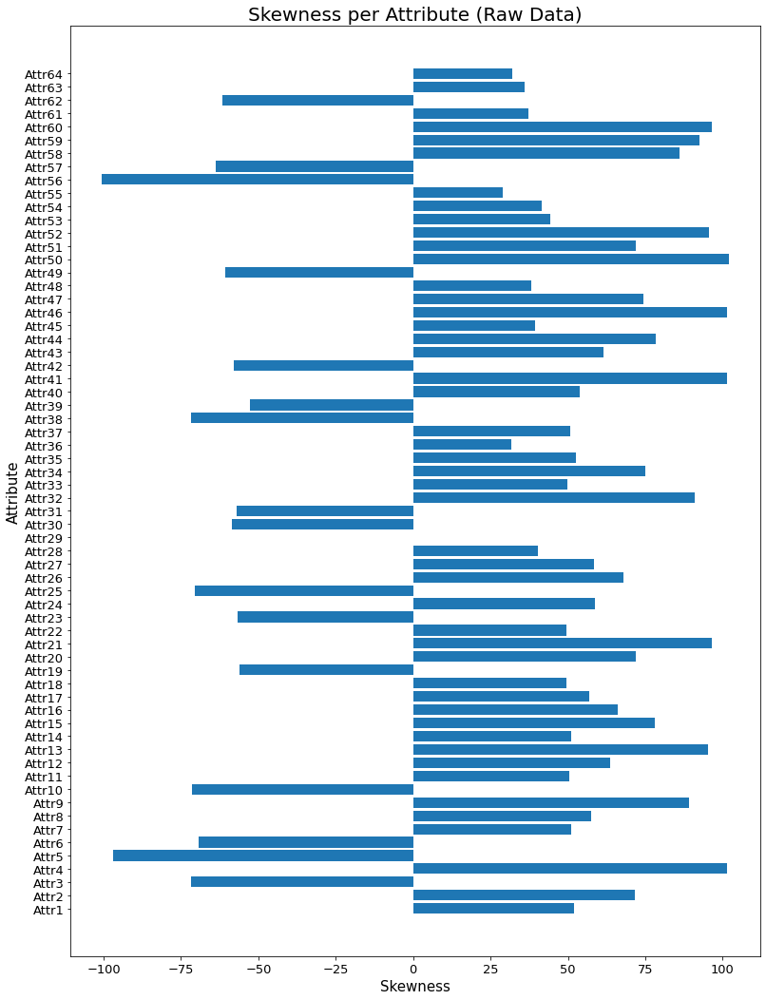

In [8]:
# Describe the Skewness
labels_  = df.loc[:, df.columns != 'class'].columns.values
skew_    = df.skew().values

# Graphically
plt.figure(figsize=(13,18))
plt.barh(labels_,skew_)
plt.plot(-1,0,"--")
plt.title('Skewness per Attribute (Raw Data)', fontsize=20)
plt.ylabel('Attribute', fontsize=15)
plt.xlabel('Skewness', fontsize=15)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.show()

### Let's check if the descriptive statistics are the same for the predictors of both classes

In [9]:
# For Class 0: No Bankruptcy
df[df["class"]=="b'0'"].describe()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr37,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,10008.000000,10008.000000,10008.000000,9991.000000,9.983000e+03,10008.000000,10008.000000,9995.000000,10006.000000,10008.000000,10008.000000,9991.000000,9968.000000,10008.000000,1.000000e+04,9995.000000,9995.000000,10008.000000,9968.000000,9968.000000,9341.000000,10008.000000,9968.000000,9781.000000,10008.000000,9995.000000,9.460000e+03,9794.000000,10008.000000,9968.000000,9968.000000,9.910000e+03,9991.000000,9995.000000,10008.000000,10008.000000,5497.000000,10008.000000,9968.000000,9991.000000,9806.000000,9968.000000,9968.000000,9968.000000,9459.000000,9991.000000,9.923000e+03,10008.000000,9968.000000,9995.000000,10008.000000,9923.000000,9794.000000,9794.000000,1.000800e+04,9968.000000,10008.000000,9981.000000,10008.000000,9.458000e+03,9993.000000,9.968000e+03,9991.000000,9794.000000
mean,0.056747,0.569086,0.144450,10.221696,-1.410525e+03,-0.069879,0.069754,19.891484,1.821402,0.417198,0.090693,2.688319,0.392365,0.069765,2.895140e+03,2.858635,21.278404,0.075122,-0.179679,68.839074,4.807916,0.080896,-0.185449,0.227763,0.251475,2.704619,1.219955e+03,6.181342,3.926993,0.330198,-0.187068,1.177200e+03,8.231136,5.449781,0.076758,1.969415,100.700264,0.516020,-0.075232,2.357731,30.153367,-0.146246,197.022380,128.182779,18.295201,9.248102,5.658948e+02,0.008384,-0.223872,8.939501,0.448377,11.771926,5.813664,6.826584,6.893994e+03,-0.553087,0.023908,3.987135,1.436746,5.963412e+02,14.035617,9.488350e+01,9.110323,35.824152
std,0.620799,4.839168,4.832888,536.375338,1.214848e+05,5.224381,0.624289,735.213527,7.753825,4.841621,0.630154,113.124078,50.884685,0.624288,1.106685e+05,112.920379,739.368623,0.822805,11.474205,1109.986186,311.655508,0.581559,11.411743,2.104898,5.090586,111.477142,3.527740e+04,96.649798,0.840649,72.822912,11.419745,6.998339e+04,26.559043,70.634812,0.581996,2.580355,2516.310314,4.836367,8.275605,37.932248,2916.219931,11.049540,3381.418533,2831.098104,1761.050150,536.294144,3.203271e+04,0.631971,12.200013,535.206392,4.830539,872.813281,91.697787,95.599627,6.113927e+04,57.343228,18.972780,194.841341,79.056957,3.803902e+04,85.671132,2.638000e+04,29.456263,436.495845
min,-17.692000,0.000000,-479.730000,0.002080,-1.190300e+07,-508.120000,-17.692000,-2.081800,-1.215700,-479.730000,-17.692000,-274.570000,-631.710000,-17.692000,-2.321800e+06,-204.300000,-0.043411,-17.692000,-771.650000,-0.001439,-1.107500,-17.692000,-771.650000,-60.742000,-500.750000,-204.300000,-1.901300e+05,-690.400000,-0.358530,-6351.700000,-771.390000,-9.295600e+03,-1.921900,-1696.000000,-17.073000,-0.000084,-2.200900,-479.730000,-551.110000,-7.081900,-667.730000,-765.800000,-25113.000000,-25113.000000,-74385.000000,-6.469200,-1.730300e+01,-17.692000,-905.750000,0.002080,0.000000,-25.467000,-869.040000,-706.490000,-7.513800e+05,-5691.700000,-1667.300000,-198.690000,-172.070000,0.000000e+00,-6.590300,-2.336500e+06,-0.000156,-0.000102
25%,0.001688,0.248762,0.024004,1.059850,-4.944450e+01,0.000000,0.003665,0.454070,1.013500,0.307395,0.011792,0.009597,0.022990,0.003673,1.996275e+02,0.069526,1.474650,0.003673,0.002635,14.263500,0.797710,0.000000,0.001252,0.022169,0.146792,0.063593,0.000000e+00,0.040517,3.395700,0.070987,0.005150,4.408425e+01,2.829500,0.377840,0.003167,1.043500,1.039000,0.441078,0.002620,0.056784,0.023103,0.000000,65.649500,34.498000,0.012108,0.623940,1.502250e+01,-0.046966,-0.034444,0.762735,0.174083,0.120880,0.689655,0.965805,3.325325e+01,0.006851,0.008476,0.874070,0.000000,5.602900e+00,4.490800,4.013025e+01,3.123700,2.024575
50%,0.045404,0.455845,0.205955,1.645900,3.284400e+00,0.000000,0.054174,1.148700,1.20

In [10]:
# For Class 1: Bankruptcy
df[df["class"]=="b'1'"].describe()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr37,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,495.000000,495.000000,495.000000,494.000000,495.000000,495.000000,495.000000,494.000000,494.000000,495.000000,495.000000,494.000000,492.000000,495.000000,4.950000e+02,494.000000,494.000000,495.000000,492.000000,492.000000,355.000000,495.000000,492.000000,495.000000,495.000000,494.000000,328.000000,481.000000,495.000000,492.000000,492.000000,492.000000,494.000000,494.000000,495.000000,495.000000,270.000000,495.000000,492.000000,494.000000,495.000000,492.000000,492.000000,492.000000,453.000000,494.000000,494.000000,495.000000,492.000000,494.000000,495.000000,494.000000,481.000000,481.000000,495.000000,492.000000,495.000000,493.000000,495.000000,453.000000,493.000000,492.000000,494.000000,481.000000
mean,-0.026058,1.647506,-0.894385,5.102372,-79.875680,-1.157958,-0.017876,3.937788,1.775757,-0.667160,0.007325,-3.192050,0.056414,-0.017876,5.210248e+03,0.120009,4.995723,-0.017876,0.009558,60.536073,1.060844,-0.029861,0.005529,-0.100797,-0.922376,0.074106,205.048812,4.291719,3.803631,3.075900,0.025191,1060.283125,12.237312,4.357885,-0.043826,2.220533,143.363855,-0.555702,-0.099122,2.852153,0.058021,-0.048993,162.302537,101.766615,-0.170094,3.515878,72.332206,-0.066940,-0.095726,3.557488,1.482937,0.642859,3.937359,4.305566,1473.912191,-0.064006,-0.797765,1.048017,1.279176,49.269673,11.903194,959.183259,8.788276,34.599026
std,1.052486,20.066524,20.051634,48.314299,426.110098,21.884731,1.054317,42.413324,2.003631,20.064870,1.039911,69.575565,2.087326,1.054317,7.348182e+04,3.751345,42.415343,1.054317,2.078919,78.680101,0.893135,0.575774,2.078597,1.836135,20.978810,3.372274,4448.080719,37.778808,0.830209,44.922636,2.067918,17403.187619,126.137162,15.668115,0.288624,3.491331,1159.927070,20.069109,0.497243,35.502926,3.774898,0.683124,577.805145,573.541930,18.172761,35.761241,376.074784,0.579440,0.811240,41.430082,20.068946,2.846043,26.396507,26.459938,22542.974717,0.797421,11.353636,0.739727,18.293456,304.863462,15.812266,16211.952025,58.398075,197.955126
min,-9.743700,0.000000,-445.880000,0.002238,-4111.300000,-486.720000,-9.743700,-0.997710,0.000000,-445.860000,-8.935200,-1543.800000,-2.716400,-9.743700,-6.023600e+05,-46.667000,0.002238,-9.743700,-5.271000,0.000000,0.007234,-9.736700,-5.271000,-38.572000,-466.290000,-46.667000,-17235.000000,-40.787000,0.944980,-2.193000,-3.178100,0.133690,0.017077,-12.711000,-2.631700,0.000000,0.011476,-445.860000,-7.755100,-0.043990,-58.523000,-3.487100,0.000000,0.000000,-206.410000,-0.043990,0.000000,-9.736700,-8.214000,0.002238,0.000000,0.000359,-39.776000,-39.776000,-146580.000000,-13.287000,-177.850000,0.000000,-94.598000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-0.078606,0.454405,-0.123695,0.791820,-90.081000,-0.099009,-0.078816,0.156545,0.944767,0.135360,-0.064601,-0.188962,-0.038826,-0.078816,-1.428100e+03,-0.071152,1.164175,-0.078816,-0.074002,13.838500,0.778060,-0.064361,-0.073536,-0.100295,-0.041815,-0.069034,-2.929450,-0.275320,3.304500,0.173728,-0.060256,61.960500,2.135575,0.186125,-0.098192,1.047750,1.033600,0.238440,-0.080389,0.024952,-0.102765,-0.056739,64.841000,29.163750,-0.537870,0.304330,12.929000,-0.105590,-0.103417,0.581538,0.302450,0.164575,0.340460,0.626660,-670.500000,-0.048665,-0.121870,0.923270,0.000000,4.453100,4.371300,60.617750,2.017900,1.979900
50%,0.004423,0.665220,0.062291,1.135850,-31.588000,0.000000,0.006295,0.476980,1.124400,0.318410,0.018317,0.014280,0.018005,0.006295,1.085100e+03,0.045881,1.499800,0.006295,0.004180,40.652500,0.953130,0.018522,0.002087,0.012636,0.180200,0.037739,0.869430,0.116150,3.873600,0.339455,0.007406,

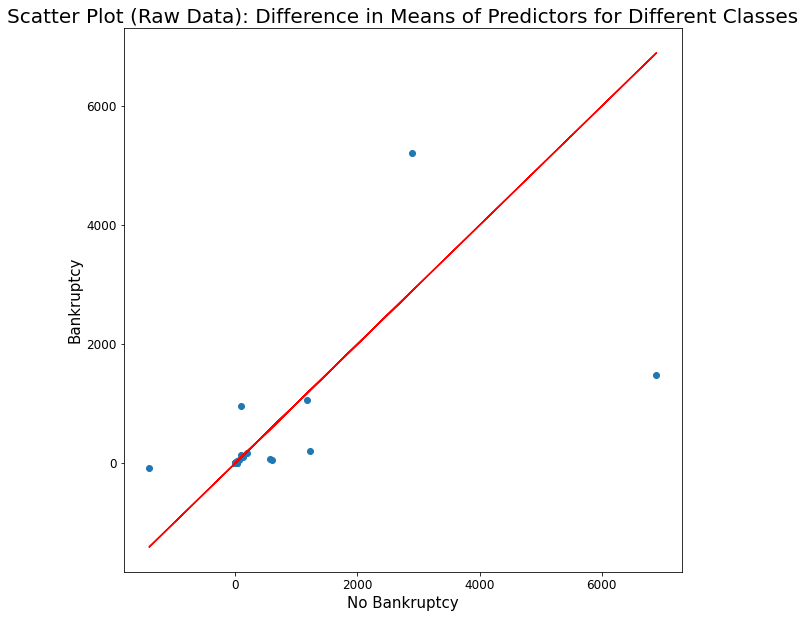

In [11]:
# Check the difference in mean graphically
b0 = df[df["class"]=="b'0'"].mean()
b1 = df[df["class"]=="b'1'"].mean()

plt.figure(figsize=(10,10))
plt.scatter(b0,b1)
plt.plot(b0, b0, '-', color = 'r')
plt.title('Scatter Plot (Raw Data): Difference in Means of Predictors for Different Classes', fontsize=20)
plt.ylabel("Bankruptcy", fontsize=15)
plt.xlabel("No Bankruptcy", fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

As can be seen above, **the means of the predictors are different for each classes.** This must be taken into consideration when inputing data.

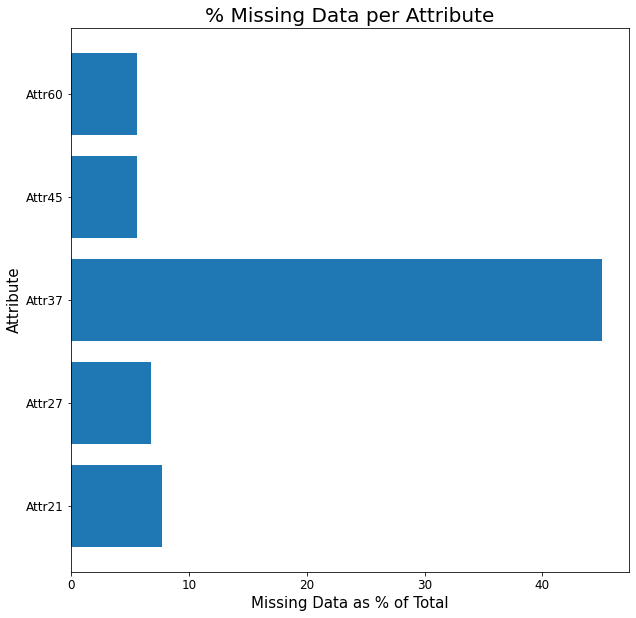

In [12]:
# First lets count for missing data per attribute
perc_md = 100*(len(df.index)-df.count())/len(df.index)

# Count only the attributes with more than 5% missing data
perc_md = perc_md[perc_md > 5]
x = perc_md.index.values
y = perc_md.values

# Graphically
plt.figure(figsize=(10,10))
plt.barh(x,y)
plt.title('% Missing Data per Attribute', fontsize=20)
plt.ylabel('Attribute', fontsize=15)
plt.xlabel('Missing Data as % of Total', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Most of the attributes show less than 10% of missing data. This can be handled. **But Attribute 37 exhibit > 40% of missing data.** This attribute is called: "(Current Assets-Inventories)/Long-Term Liabilities".

### Checking for Collinearities

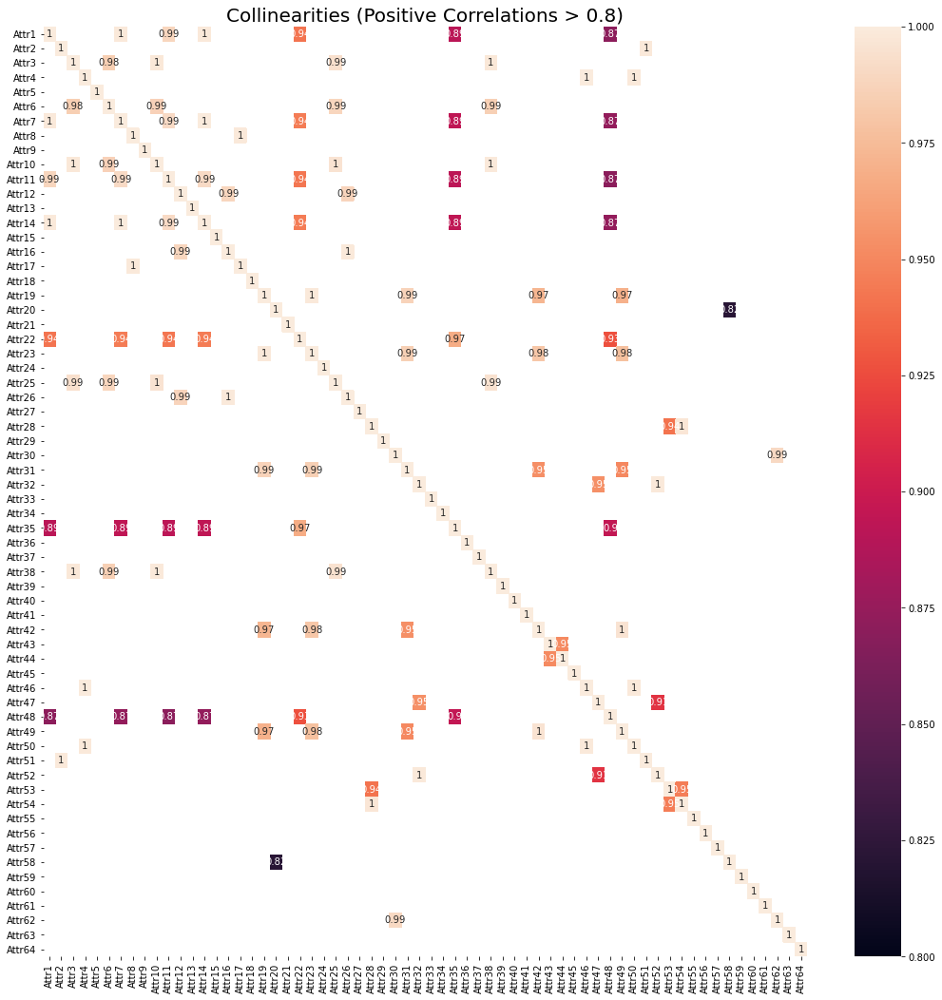

In [13]:
# Big Picture: Positive Correlations
corr_mat = df.corr()

plt.figure(figsize=(18,18))
ax = sns.heatmap(corr_mat[corr_mat>0.8], vmin = 0.8, vmax = 1, annot=True)
ax.set_title('Collinearities (Positive Correlations > 0.8)', fontsize=20)
plt.show()

There are many attributes that seems to be in collinearity with each other, with a positive correlation. This must be assessed in detail.

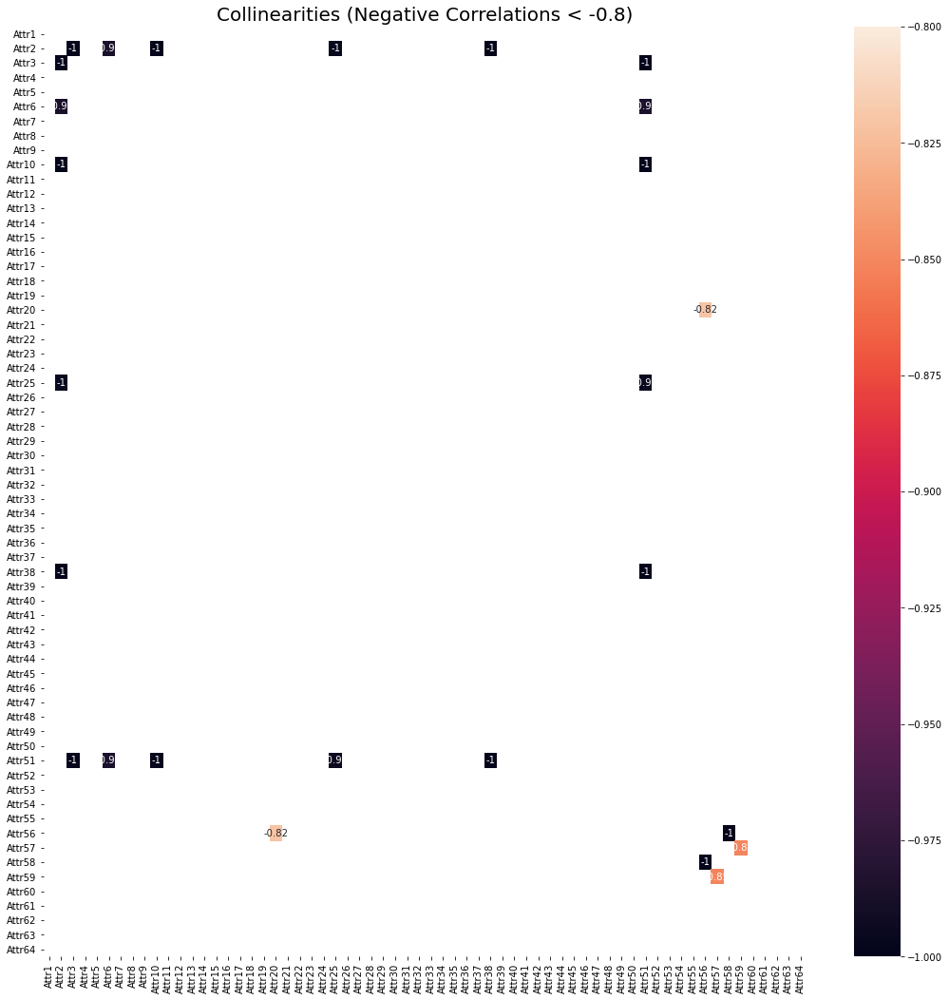

In [14]:
# Big Picture: Negative Correlations
corr_mat = df.corr()

plt.figure(figsize=(18,18))
ax = sns.heatmap(corr_mat[corr_mat<-0.8], vmin = -1, vmax = -0.8, annot=True)
ax.set_title('Collinearities (Negative Correlations < -0.8)', fontsize=20)
plt.show()

There are many attributes that seems to be in collinearity with each other, with a negative correlation. This must be assessed in detail.

In [15]:
# Check especifically for collinearities
corr_mat = df.corr()

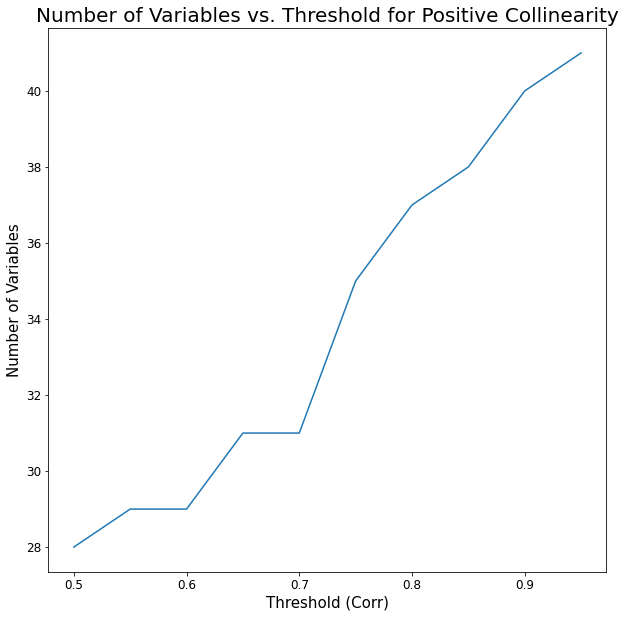

In [16]:
# The number of variables to pick is depending on the threshold for collinearity
# Check graphically

threshold_range = [0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95]
threshold_ = []
variables_ = []

for threshold in threshold_range:
    countclus = 0
    cumulative_ = []
    for i in range(1,65):
        name = "Attr"+str(i)

        if name not in cumulative_:
            countclus = countclus + 1
            clus = pd.DataFrame()
            clus["Corr"] = corr_mat[name][corr_mat[name]>threshold].round(decimals=3)
            clus["Count"] = df.count()[clus.index]
            cumulative_.extend(clus.index)
    
    threshold_.append(threshold)
    variables_.append(countclus)

plt.figure(figsize=(10,10))
plt.plot(threshold_,variables_)
plt.title('Number of Variables vs. Threshold for Positive Collinearity', fontsize=20)
plt.ylabel('Number of Variables', fontsize=15)
plt.xlabel('Threshold (Corr)', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

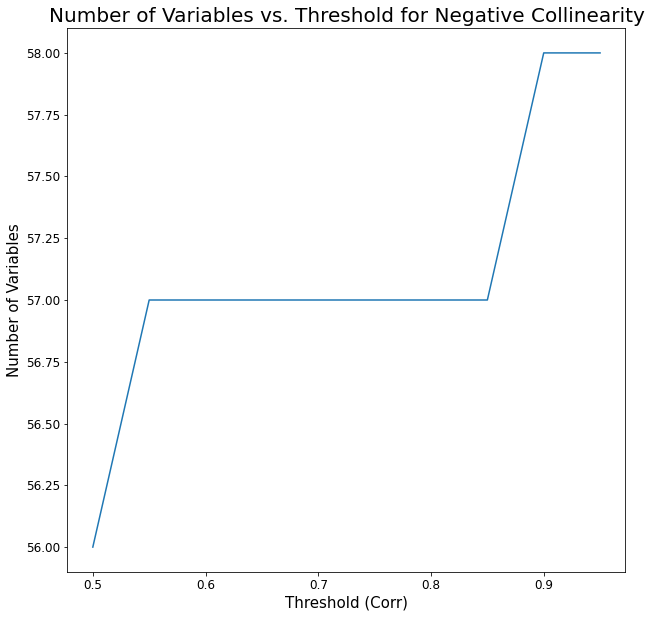

In [17]:
# The number of variables to pick is depending on the threshold for collinearity
# Check graphically

threshold_range = [0.5,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95]
threshold_ = []
variables_ = []

for threshold in threshold_range:
    countclus = 0
    cumulative_ = []
    for i in range(1,65):
        name = "Attr"+str(i)

        if name not in cumulative_:
            countclus = countclus + 1
            clus = pd.DataFrame()
            clus["Corr"] = corr_mat[name][corr_mat[name]<-threshold].round(decimals=3)
            clus["Count"] = df.count()[clus.index]
            cumulative_.extend(clus.index)
    
    threshold_.append(threshold)
    variables_.append(countclus)

plt.figure(figsize=(10,10))
plt.plot(threshold_,variables_)
plt.title('Number of Variables vs. Threshold for Negative Collinearity', fontsize=20)
plt.ylabel('Number of Variables', fontsize=15)
plt.xlabel('Threshold (Corr)', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Base on collinearity:
- 8 variables can be deleted for having collinearity with high negative correlation (< -0.85)
- if we use a threshold of 0.88, 25 variables can be deleted.

In sum, it seems we will have a total of 31 predictors. Nonetheless we need to check in detail by group.

In [18]:
# Let's check for the collinearity with positive correlation
threshold = 0.88

cumulative_ = []
countclus = 0

for i in range(1,65):
    name = "Attr"+str(i)
    
    if name not in cumulative_:
        countclus = countclus + 1
        clus = pd.DataFrame()
        clus["Corr"] = corr_mat[name][corr_mat[name]>threshold].round(decimals=3)
        clus["Count"] = df.count()[clus.index]
        cumulative_.extend(clus.index)
        print(clus,"\n")

print("Number of Variables to Use: ",countclus)

         Corr  Count
Attr1   1.000  10503
Attr7   0.999  10503
Attr11  0.989  10503
Attr14  0.999  10503
Attr22  0.942  10503
Attr35  0.892  10503 

         Corr  Count
Attr2   1.000  10503
Attr51  0.999  10503 

         Corr  Count
Attr3   1.000  10503
Attr6   0.985  10503
Attr10  0.998  10503
Attr25  0.994  10503
Attr38  0.998  10503 

         Corr  Count
Attr4   1.000  10485
Attr46  1.000  10485
Attr50  0.999  10489 

       Corr  Count
Attr5   1.0  10478 

         Corr  Count
Attr8   1.000  10489
Attr17  0.999  10489 

       Corr  Count
Attr9   1.0  10500 

         Corr  Count
Attr12  1.000  10485
Attr16  0.989  10489
Attr26  0.988  10489 

        Corr  Count
Attr13   1.0  10460 

        Corr  Count
Attr15   1.0  10495 

        Corr  Count
Attr18   1.0  10503 

         Corr  Count
Attr19  1.000  10460
Attr23  0.999  10460
Attr31  0.987  10460
Attr42  0.973  10460
Attr49  0.970  10460 

        Corr  Count
Attr20   1.0  10460 

        Corr  Count
Attr21   1.0   9696 

   

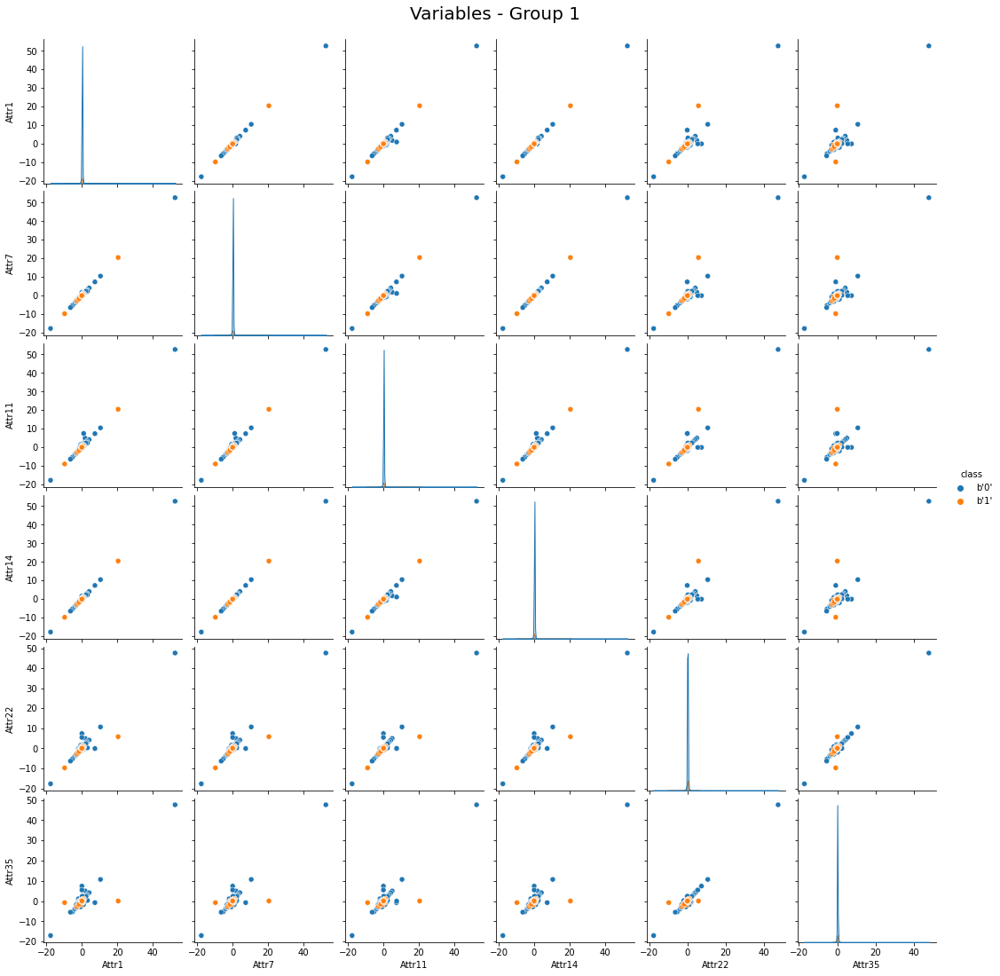

In [19]:
# Pairplot for Variables-Group 1
df_ = df[["Attr1","Attr7","Attr11","Attr14","Attr22","Attr35","class"]]
ax = sns.pairplot(df_.dropna(), hue="class")
ax.fig.suptitle("Variables - Group 1", y = 1.02, fontsize = 20)
plt.show()

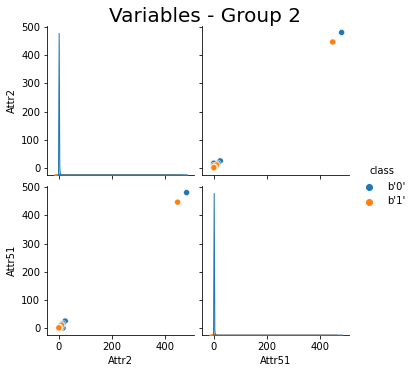

In [20]:
# Pairplot for Variables-Group 2
df_ = df[["Attr2","Attr51","class"]]
ax = sns.pairplot(df_.dropna(), hue="class")
ax.fig.suptitle("Variables - Group 2", y = 1.02, fontsize = 20)
plt.show()

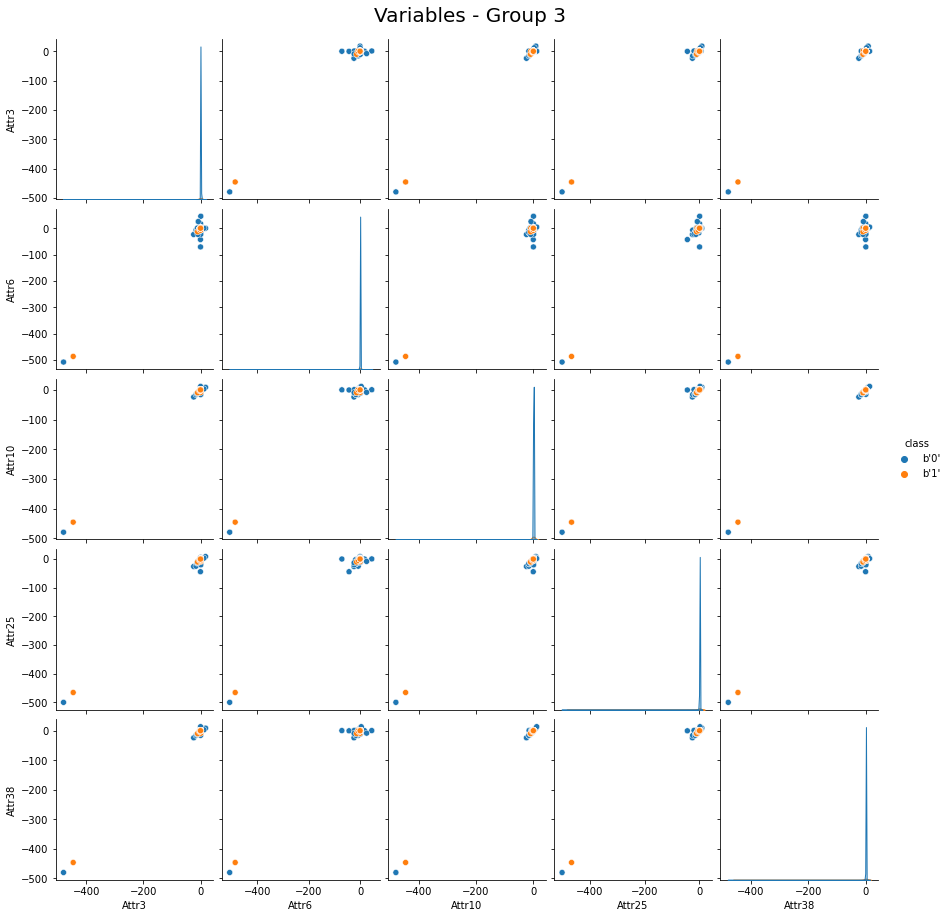

In [21]:
# Pairplot for Variables-Group 3
df_ = df[["Attr3","Attr6","Attr10", "Attr25", "Attr38","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 3", y = 1.02, fontsize = 20)
plt.show()

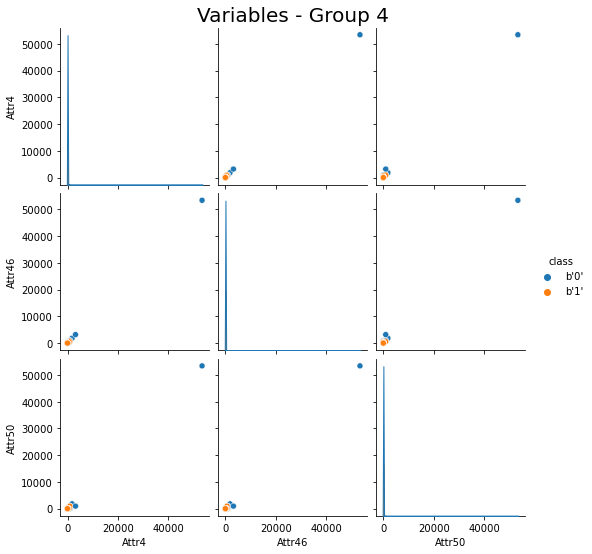

In [22]:
# Pairplot for Variables-Group 4
df_ = df[["Attr4","Attr46","Attr50","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 4", y = 1.02, fontsize = 20)
plt.show()

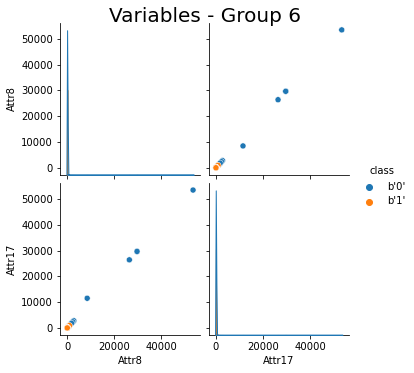

In [23]:
# Pairplot for Variables-Group 6
df_ = df[["Attr8","Attr17","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 6", y = 1.02, fontsize = 20)
plt.show()

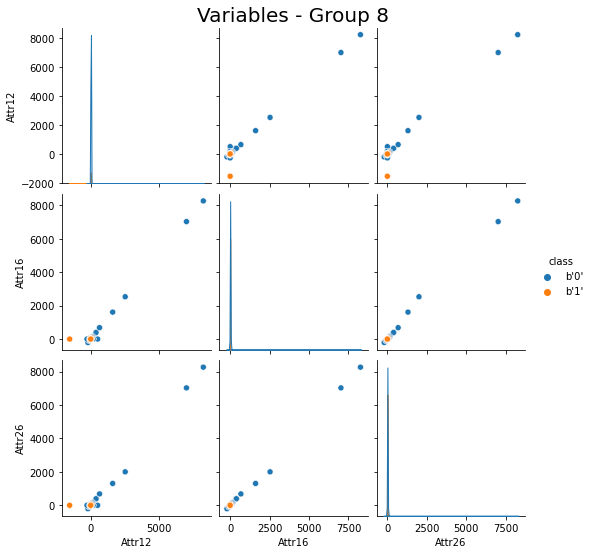

In [24]:
# Pairplot for Variables-Group 8
df_ = df[["Attr12","Attr16","Attr26","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 8", y = 1.02, fontsize = 20)
plt.show()

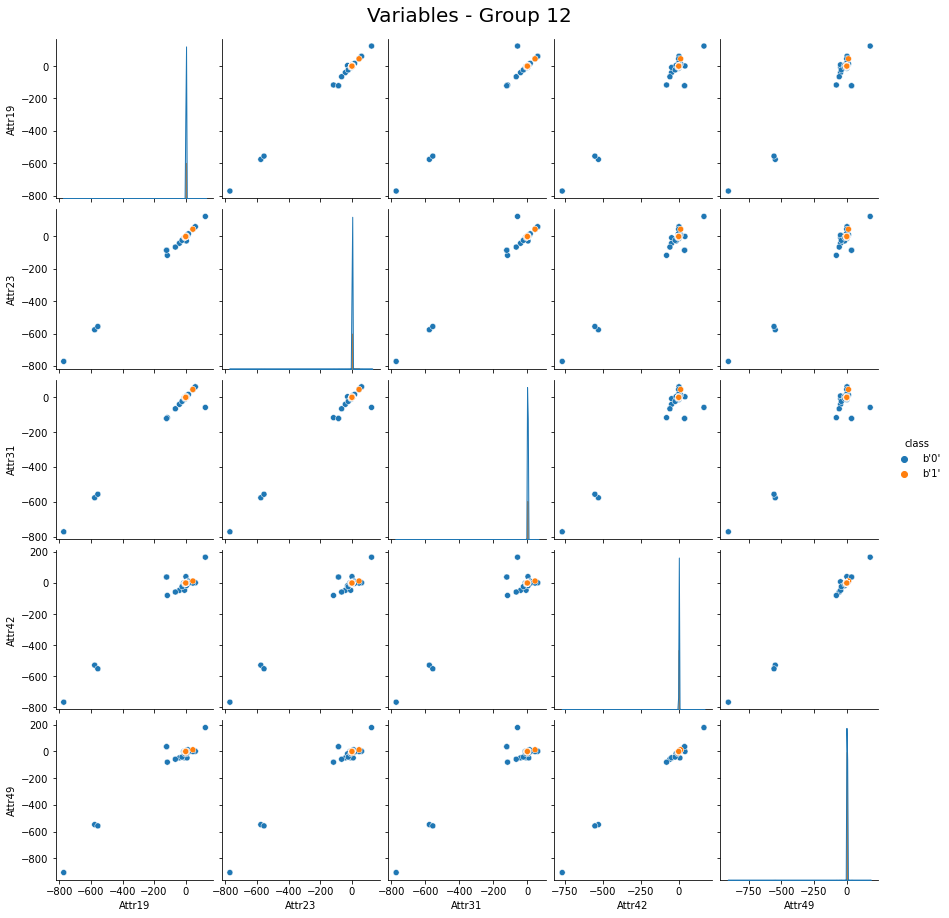

In [25]:
# Pairplot for Variables-Group 12
df_ = df[["Attr19","Attr23","Attr31","Attr42","Attr49","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 12", y = 1.02, fontsize = 20)
plt.show()

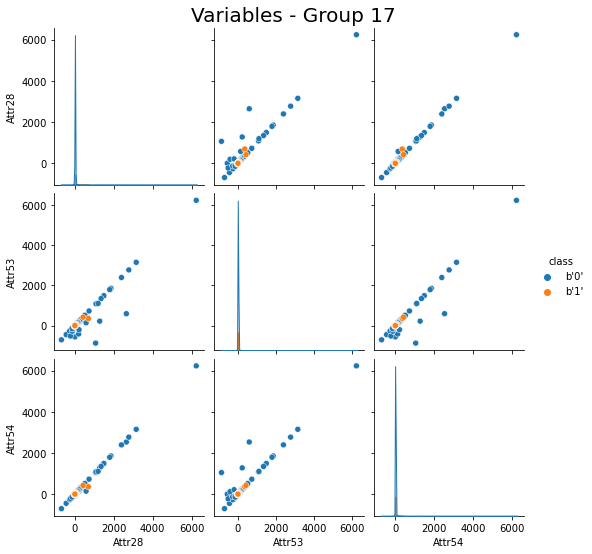

In [26]:
# Pairplot for Variables-Group 17
df_ = df[["Attr28","Attr53","Attr54","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 17", y = 1.02, fontsize = 20)
plt.show()

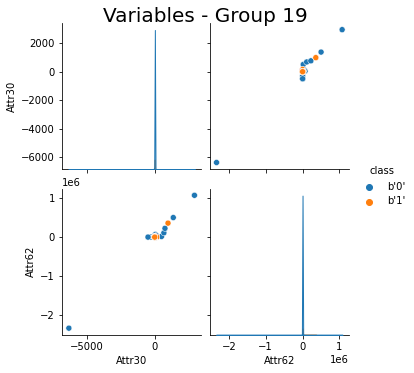

In [27]:
# Pairplot for Variables-Group 19
df_ = df[["Attr30","Attr62","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 19", y = 1.02, fontsize = 20)
plt.show()

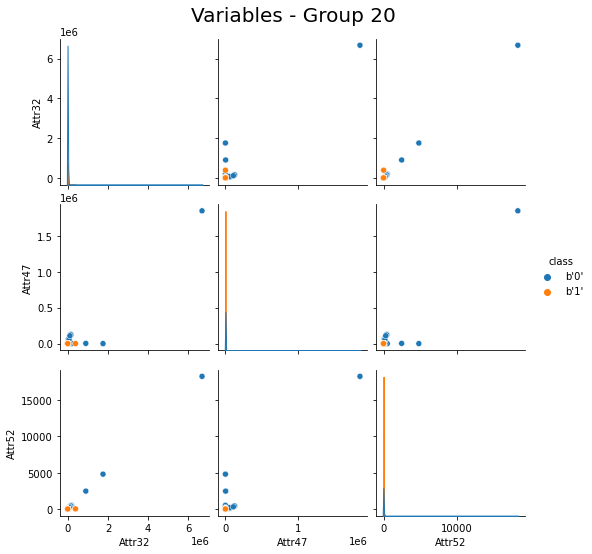

In [28]:
# Pairplot for Variables-Group 20
df_ = df[["Attr32","Attr47","Attr52","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 20", y = 1.02, fontsize = 20)
plt.show()

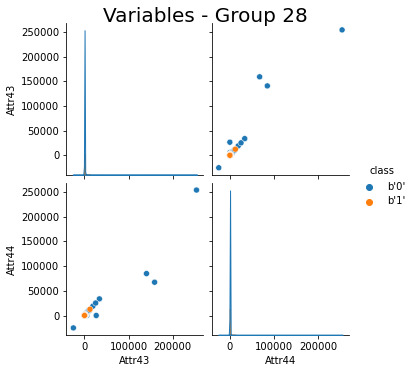

In [29]:
# Pairplot for Variables-Group 28
df_ = df[["Attr43","Attr44","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 28", y = 1.02, fontsize = 20)
plt.show()

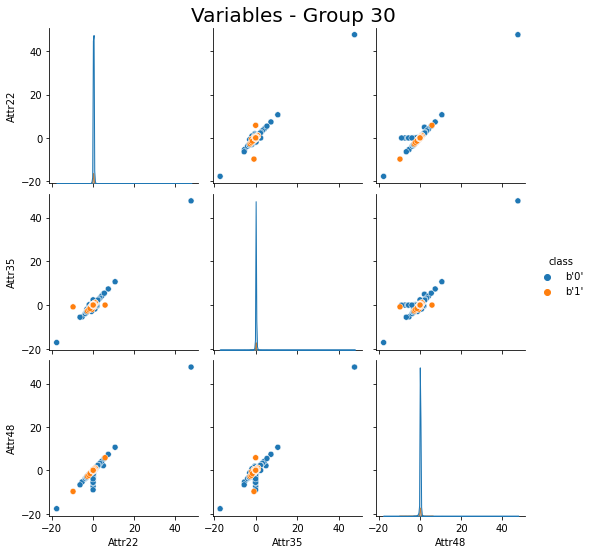

In [30]:
# Pairplot for Variables-Group 30
df_ = df[["Attr22","Attr35","Attr48","class"]]
ax = sns.pairplot(df_.dropna(),hue="class")
ax.fig.suptitle("Variables - Group 30", y = 1.02, fontsize = 20)
plt.show()

As seen in the above, there exists several outliers in different attributes that mislead the interpretation of the correlations. Because of this **we cannot select variables before imputing and cleaning the data**.

## Data Inputation

Data Inputation must be done for each class separately, as they exhibit different means for the predictors. This is made deleting Attribute47, as this exhibit more than 40% of missing data.

In [31]:
# We define the dataframe from where we are going to do modification
df_inputation = df_orig.copy(deep=True)

# We delete attribute 37
df_inputation = df_inputation.drop('Attr37', 1)

# We create two dataframes for each class, as the predictors show different means per class
df_inp0 = df_inputation[df_inputation["class"]=="b'0'"]
df_inp1 = df_inputation[df_inputation["class"]=="b'1'"]

In [32]:
# Describe df_ipn0: Inputation Dataframe for Class 0
df_inp0 = df_inp0.drop('class', 1)
df_inp0.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,10008.000,10008.000,10008.000,9991.000,9.983000e+03,10008.000,10008.000,9995.000,10006.000,10008.000,10008.000,9991.000,9968.000,10008.000,1.000000e+04,9995.000,9995.000,10008.000,9968.000,9968.000,9341.000,10008.000,9968.000,9781.000,10008.000,9995.000,9460.000,9794.000,10008.000,9968.000,9968.000,9910.000,9991.000,9995.000,10008.000,10008.000,10008.000,9968.000,9991.000,9806.000,9968.000,9968.000,9968.000,9459.000,9991.000,9923.000,10008.000,9968.000,9995.000,10008.000,9923.000,9794.000,9794.000,10008.000,9968.000,10008.000,9981.000,10008.000,9458.000,9993.000,9968.000,9991.000,9794.000
mean,0.057,0.569,0.144,10.222,-1.410525e+03,-0.070,0.070,19.891,1.821,0.417,0.091,2.688,0.392,0.070,2.895140e+03,2.859,21.278,0.075,-0.180,68.839,4.808,0.081,-0.185,0.228,0.251,2.705,1219.955,6.181,3.927,0.330,-0.187,1177.200,8.231,5.450,0.077,1.969,0.516,-0.075,2.358,30.153,-0.146,197.022,128.183,18.295,9.248,565.895,0.008,-0.224,8.940,0.448,11.772,5.814,6.827,6893.994,-0.553,0.024,3.987,1.437,596.341,14.036,94.884,9.110,35.824
std,0.621,4.839,4.833,536.375,1.214848e+05,5.224,0.624,735.214,7.754,4.842,0.630,113.124,50.885,0.624,1.106685e+05,112.920,739.369,0.823,11.474,1109.986,311.656,0.582,11.412,2.105,5.091,111.477,35277.397,96.650,0.841,72.823,11.420,69983.392,26.559,70.635,0.582,2.580,4.836,8.276,37.932,2916.220,11.050,3381.419,2831.098,1761.050,536.294,32032.712,0.632,12.200,535.206,4.831,872.813,91.698,95.600,61139.265,57.343,18.973,194.841,79.057,38039.017,85.671,26380.001,29.456,436.496
min,-17.692,0.000,-479.730,0.002,-1.190300e+07,-508.120,-17.692,-2.082,-1.216,-479.730,-17.692,-274.570,-631.710,-17.692,-2.321800e+06,-204.300,-0.043,-17.692,-771.650,-0.001,-1.108,-17.692,-771.650,-60.742,-500.750,-204.300,-190130.000,-690.400,-0.359,-6351.700,-771.390,-9295.600,-1.922,-1696.000,-17.073,-0.000,-479.730,-551.110,-7.082,-667.730,-765.800,-25113.000,-25113.000,-74385.000,-6.469,-17.303,-17.692,-905.750,0.002,0.000,-25.467,-869.040,-706.490,-751380.000,-5691.700,-1667.300,-198.690,-172.070,0.000,-6.590,-2336500.000,-0.000,-0.000
25%,0.002,0.249,0.024,1.060,-4.944400e+01,0.000,0.004,0.454,1.014,0.307,0.012,0.010,0.023,0.004,1.996280e+02,0.070,1.475,0.004,0.003,14.264,0.798,0.000,0.001,0.022,0.147,0.064,0.000,0.041,3.396,0.071,0.005,44.084,2.830,0.378,0.003,1.044,0.441,0.003,0.057,0.023,0.000,65.650,34.498,0.012,0.624,15.022,-0.047,-0.034,0.763,0.174,0.121,0.690,0.966,33.253,0.007,0.008,0.874,0.000,5.603,4.491,40.130,3.124,2.025
50%,0.045,0.456,0.206,1.646,3.284000e+00,0.000,0.054,1.149,1.200,0.525,0.071,0.167,0.070,0.054,8.009050e+02,0.250,2.191,0.054,0.034,34.289,0.955,0.057,0.029,0.168,0.392,0.229,1.071,0.477,3.935,0.211,0.042,76.318,4.738,2.071,0.056,1.582,0.637,0.036,0.204,0.079,0.037,98.864,54.453,0.283,1.087,37.072,0.011,0.007,1.256,0.320,0.209,1.219,1.392,938.135,0.054,0.110,0.952,0.003,10.016,6.667,69.300,5.232,4.057
75%,0.127,0.678,0.426,3.019,5.863800e+01,0.083,0.146,2.935,2.057,0.731,0.164,0.595,0.137,0.146,2.142550e+03,0.671,4.005,0.146,0.090,63.130,1.106,0.149,0.078,0.385,0.622,0.612,4.915,1.582,4.454,0.416,0.101,126.948,8.187,4.842,0.148,2.370,0.793,0.093,0.772,0.190,0.093,140.732,80.766,0.987,2.093,69.649,0.104,0.061,2.363,0.514,0.348,2.302,2.464,4513.600,0.132,0.272,0.995,0.236,21.026,10.527,115.862,9.030,9.676
max,52.652,480.730,17.708,53433.000,6.854400e+05,45.533,52.652,53432.000,740.440,11.837,52.652,8259.400,4972.000,52.652,1.023600e+07,8259.400,53433.000,53.689,123.940,91600.000,29907.000,47.597,123.940,179.920,8.834,8262.300,2723000.000,6233.300,9.620,2940.500,60.430,6674200.000,1696

In [33]:
# Describe df_ipn1: Inputation Dataframe for Class 1
df_inp1 = df_inp1.drop('class', 1)
df_inp1.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,495.000,495.000,495.000,494.000,495.000,495.000,495.000,494.000,494.000,495.000,495.000,494.000,492.000,495.000,495.000,494.000,494.000,495.000,492.000,492.000,355.000,495.000,492.000,495.000,495.000,494.000,328.000,481.000,495.000,492.000,492.000,492.000,494.000,494.000,495.000,495.000,495.000,492.000,494.000,495.000,492.000,492.000,492.000,453.000,494.000,494.000,495.000,492.000,494.000,495.000,494.000,481.000,481.000,495.000,492.000,495.000,493.000,495.000,453.000,493.000,492.000,494.000,481.000
mean,-0.026,1.648,-0.894,5.102,-79.876,-1.158,-0.018,3.938,1.776,-0.667,0.007,-3.192,0.056,-0.018,5210.248,0.120,4.996,-0.018,0.010,60.536,1.061,-0.030,0.006,-0.101,-0.922,0.074,205.049,4.292,3.804,3.076,0.025,1060.283,12.237,4.358,-0.044,2.221,-0.556,-0.099,2.852,0.058,-0.049,162.303,101.767,-0.170,3.516,72.332,-0.067,-0.096,3.557,1.483,0.643,3.937,4.306,1473.912,-0.064,-0.798,1.048,1.279,49.270,11.903,959.183,8.788,34.599
std,1.052,20.067,20.052,48.314,426.110,21.885,1.054,42.413,2.004,20.065,1.040,69.576,2.087,1.054,73481.823,3.751,42.415,1.054,2.079,78.680,0.893,0.576,2.079,1.836,20.979,3.372,4448.081,37.779,0.830,44.923,2.068,17403.188,126.137,15.668,0.289,3.491,20.069,0.497,35.503,3.775,0.683,577.805,573.542,18.173,35.761,376.075,0.579,0.811,41.430,20.069,2.846,26.397,26.460,22542.975,0.797,11.354,0.740,18.293,304.863,15.812,16211.952,58.398,197.955
min,-9.744,0.000,-445.880,0.002,-4111.300,-486.720,-9.744,-0.998,0.000,-445.860,-8.935,-1543.800,-2.716,-9.744,-602360.000,-46.667,0.002,-9.744,-5.271,0.000,0.007,-9.737,-5.271,-38.572,-466.290,-46.667,-17235.000,-40.787,0.945,-2.193,-3.178,0.134,0.017,-12.711,-2.632,0.000,-445.860,-7.755,-0.044,-58.523,-3.487,0.000,0.000,-206.410,-0.044,0.000,-9.737,-8.214,0.002,0.000,0.000,-39.776,-39.776,-146580.000,-13.287,-177.850,0.000,-94.598,0.000,0.000,0.000,0.000,0.000
25%,-0.079,0.454,-0.124,0.792,-90.081,-0.099,-0.079,0.157,0.945,0.135,-0.065,-0.189,-0.039,-0.079,-1428.100,-0.071,1.164,-0.079,-0.074,13.838,0.778,-0.064,-0.074,-0.100,-0.042,-0.069,-2.929,-0.275,3.304,0.174,-0.060,61.960,2.136,0.186,-0.098,1.048,0.238,-0.080,0.025,-0.103,-0.057,64.841,29.164,-0.538,0.304,12.929,-0.106,-0.103,0.582,0.302,0.165,0.340,0.627,-670.500,-0.049,-0.122,0.923,0.000,4.453,4.371,60.618,2.018,1.980
50%,0.004,0.665,0.062,1.136,-31.588,0.000,0.006,0.477,1.124,0.318,0.018,0.014,0.018,0.006,1085.100,0.046,1.500,0.006,0.004,40.652,0.953,0.019,0.002,0.013,0.180,0.038,0.869,0.116,3.874,0.339,0.007,109.640,3.509,1.737,0.007,1.686,0.440,0.004,0.070,0.109,0.010,104.040,52.154,0.018,0.595,38.204,-0.012,-0.007,0.891,0.500,0.287,0.794,1.022,133.980,0.015,0.033,0.984,0.000,8.093,6.965,104.100,3.482,4.194
75%,0.046,0.858,0.255,1.680,8.186,0.000,0.053,1.123,2.144,0.520,0.078,0.121,0.057,0.053,3990.000,0.172,2.189,0.053,0.030,78.712,1.109,0.073,0.027,0.118,0.371,0.148,2.952,0.929,4.359,0.619,0.040,181.100,6.076,3.677,0.068,2.584,0.636,0.043,0.301,0.299,0.046,155.995,82.204,0.254,1.051,74.951,0.042,0.025,1.300,0.715,0.468,1.602,1.838,1527.100,0.077,0.234,1.048,0.324,18.591,12.320,176.630,5.925,10.022
max,20.481,446.880,0.999,916.500,2586.500,0.910,20.481,915.500,31.417,0.999,20.481,65.540,45.110,20.481,1379200.000,65.461,916.500,20.481,45.110,663.600,11.721,5.823,45.110,1.720,0.994,54.581,78115.000,689.980,6.263,984.000,45.110,385260.000,2787.900,278.830,1.064,64.175,0.999,0.290,569.330,39.227,12.825,12523.000,12523.000,251.280,577.500,8281.800,5.823,12.825,916.500,446.880,58.558,420.920,420.920,354620.000,1.000,29.554,14.295,379.170,5500.000,144.690,359250.000,1266.200,3544.600


### Cleaning the Data: Replace NaN with the Median

In [34]:
# Predictors for Class 0
df_inp0 = df_inp0.fillna(df_inp0.median())
df_inp0.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,10008.000,10008.000,10008.000,10008.000,1.000800e+04,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,1.000800e+04,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000,10008.000
mean,0.057,0.569,0.144,10.207,-1.406993e+03,-0.070,0.070,19.867,1.821,0.417,0.091,2.684,0.391,0.070,2.893466e+03,2.855,21.254,0.075,-0.179,68.701,4.551,0.081,-0.185,0.226,0.251,2.701,1153.214,6.059,3.927,0.330,-0.186,1166.420,8.225,5.445,0.077,1.969,0.516,-0.075,2.354,29.546,-0.146,196.630,127.888,17.307,9.234,561.403,0.008,-0.223,8.930,0.448,11.674,5.715,6.710,6893.994,-0.551,0.024,3.979,1.437,564.119,14.025,94.781,9.104,35.145
std,0.621,4.839,4.833,535.920,1.213330e+05,5.224,0.624,734.736,7.753,4.842,0.630,113.028,50.783,0.624,1.106243e+05,112.847,738.889,0.823,11.451,1107.768,301.092,0.582,11.389,2.081,5.091,111.405,34298.995,95.614,0.841,72.677,11.397,69639.954,26.537,70.589,0.582,2.580,4.836,8.259,37.900,2886.640,11.027,3374.659,2825.438,1712.067,535.839,31896.415,0.632,12.176,534.859,4.831,869.099,90.714,94.575,61139.265,57.229,18.973,194.578,79.057,36979.145,85.607,26327.225,29.432,431.828
min,-17.692,0.000,-479.730,0.002,-1.190300e+07,-508.120,-17.692,-2.082,-1.216,-479.730,-17.692,-274.570,-631.710,-17.692,-2.321800e+06,-204.300,-0.043,-17.692,-771.650,-0.001,-1.108,-17.692,-771.650,-60.742,-500.750,-204.300,-190130.000,-690.400,-0.359,-6351.700,-771.390,-9295.600,-1.922,-1696.000,-17.073,-0.000,-479.730,-551.110,-7.082,-667.730,-765.800,-25113.000,-25113.000,-74385.000,-6.469,-17.303,-17.692,-905.750,0.002,0.000,-25.467,-869.040,-706.490,-751380.000,-5691.700,-1667.300,-198.690,-172.070,0.000,-6.590,-2336500.000,-0.000,-0.000
25%,0.002,0.249,0.024,1.061,-4.922300e+01,0.000,0.004,0.454,1.014,0.307,0.012,0.010,0.023,0.004,2.003580e+02,0.070,1.475,0.004,0.003,14.423,0.812,0.000,0.001,0.026,0.147,0.064,0.020,0.050,3.396,0.071,0.005,44.415,2.832,0.379,0.003,1.044,0.441,0.003,0.057,0.024,0.000,65.833,34.563,0.021,0.625,15.270,-0.047,-0.034,0.763,0.174,0.122,0.702,0.976,33.253,0.007,0.008,0.874,0.000,5.784,4.492,40.302,3.126,2.057
50%,0.045,0.456,0.206,1.646,3.284000e+00,0.000,0.054,1.149,1.200,0.525,0.071,0.167,0.070,0.054,8.009050e+02,0.250,2.191,0.054,0.034,34.289,0.955,0.057,0.029,0.168,0.392,0.229,1.071,0.477,3.935,0.211,0.042,76.318,4.738,2.071,0.056,1.582,0.637,0.036,0.204,0.079,0.037,98.864,54.453,0.283,1.087,37.072,0.011,0.007,1.256,0.320,0.209,1.219,1.392,938.135,0.054,0.110,0.952,0.003,10.016,6.667,69.300,5.232,4.057
75%,0.127,0.678,0.426,3.016,5.848400e+01,0.083,0.146,2.932,2.057,0.731,0.164,0.593,0.137,0.146,2.140325e+03,0.670,3.996,0.146,0.090,63.035,1.091,0.149,0.078,0.378,0.622,0.611,4.423,1.542,4.454,0.415,0.101,125.932,8.176,4.829,0.148,2.370,0.793,0.093,0.770,0.187,0.093,140.650,80.632,0.914,2.089,69.256,0.104,0.061,2.359,0.514,0.346,2.255,2.419,4513.600,0.132,0.272,0.995,0.236,19.927,10.513,115.470,9.020,9.450
max,52.652,480.730,17.708,53433.000,6.854400e+05,45.533,52.652,53432.000,740.440,11.837,52.652,8259.400,4972.000,52.652,1.023600e+07,8259.400,53433.000,53.689,123.940,91600.000,29907.000,47.597,123.940,179.920,8.834,8262.300,2723000.000,6233.30

In [35]:
# Predictors for Class 1
df_inp1 = df_inp1.fillna(df_inp1.median())
df_inp1.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000,495.000
mean,-0.026,1.648,-0.894,5.094,-79.876,-1.158,-0.018,3.931,1.774,-0.667,0.007,-3.186,0.056,-0.018,5210.248,0.120,4.989,-0.018,0.010,60.416,1.030,-0.030,0.006,-0.101,-0.922,0.074,136.164,4.174,3.804,3.059,0.025,1054.522,12.220,4.353,-0.044,2.221,-0.556,-0.098,2.847,0.058,-0.049,161.949,101.466,-0.154,3.510,72.263,-0.067,-0.095,3.552,1.483,0.642,3.848,4.213,1473.912,-0.064,-0.798,1.048,1.279,45.776,11.883,954.001,8.778,33.739
std,1.052,20.067,20.052,48.266,426.110,21.885,1.054,42.371,2.002,20.065,1.040,69.505,2.081,1.054,73481.823,3.748,42.373,1.054,2.073,78.456,0.758,0.576,2.072,1.836,20.979,3.369,3620.244,37.246,0.830,44.787,2.062,17350.421,126.010,15.653,0.289,3.491,20.069,0.496,35.467,3.775,0.681,576.066,571.811,17.383,35.725,375.697,0.579,0.809,41.388,20.069,2.843,26.025,26.088,22542.975,0.795,11.354,0.738,18.293,291.842,15.783,16162.787,58.339,195.195
min,-9.744,0.000,-445.880,0.002,-4111.300,-486.720,-9.744,-0.998,0.000,-445.860,-8.935,-1543.800,-2.716,-9.744,-602360.000,-46.667,0.002,-9.744,-5.271,0.000,0.007,-9.737,-5.271,-38.572,-466.290,-46.667,-17235.000,-40.787,0.945,-2.193,-3.178,0.134,0.017,-12.711,-2.632,0.000,-445.860,-7.755,-0.044,-58.523,-3.487,0.000,0.000,-206.410,-0.044,0.000,-9.737,-8.214,0.002,0.000,0.000,-39.776,-39.776,-146580.000,-13.287,-177.850,0.000,-94.598,0.000,0.000,0.000,0.000,0.000
25%,-0.079,0.454,-0.124,0.792,-90.081,-0.099,-0.079,0.157,0.945,0.135,-0.065,-0.189,-0.038,-0.079,-1428.100,-0.071,1.165,-0.079,-0.071,13.890,0.846,-0.064,-0.073,-0.100,-0.042,-0.069,-0.290,-0.265,3.304,0.175,-0.057,62.158,2.136,0.188,-0.098,1.048,0.238,-0.080,0.025,-0.103,-0.056,65.151,29.333,-0.447,0.304,12.939,-0.106,-0.102,0.582,0.302,0.165,0.351,0.634,-670.500,-0.048,-0.122,0.924,0.000,4.636,4.390,61.078,2.021,2.013
50%,0.004,0.665,0.062,1.136,-31.588,0.000,0.006,0.477,1.124,0.318,0.018,0.014,0.018,0.006,1085.100,0.046,1.500,0.006,0.004,40.652,0.953,0.019,0.002,0.013,0.180,0.038,0.869,0.116,3.874,0.339,0.007,109.640,3.509,1.737,0.007,1.686,0.440,0.004,0.070,0.109,0.010,104.040,52.154,0.018,0.595,38.204,-0.012,-0.007,0.891,0.500,0.287,0.794,1.022,133.980,0.015,0.033,0.984,0.000,8.093,6.965,104.100,3.482,4.194
75%,0.046,0.858,0.255,1.679,8.186,0.000,0.053,1.122,2.143,0.520,0.078,0.120,0.057,0.053,3990.000,0.172,2.178,0.053,0.030,78.454,1.058,0.073,0.027,0.118,0.371,0.148,1.518,0.921,4.359,0.617,0.040,179.550,6.065,3.669,0.068,2.584,0.636,0.043,0.299,0.299,0.045,155.460,81.820,0.204,1.048,74.876,0.042,0.025,1.299,0.715,0.468,1.556,1.738,1527.100,0.077,0.234,1.047,0.324,16.420,12.289,176.060,5.913,9.528
max,20.481,446.880,0.999,916.500,2586.500,0.910,20.481,915.500,31.417,0.999,20.481,65.540,45.110,20.481,1379200.000,65.461,916.500,20.481,45.110,663.600,11.721,5.823,45.110,1.720,0.994,54.581,78115.000,689.980,6.263,984.000,45.110,385260.000,2787.900,278.830,1.064,64.175,0.999,0.290,569.330,39.227,12.825,12523.000,12523.000,251.280,577.500,8281.800,5.823,12.825,916.500,446.880,58.558,420.920,420.920,354620.000,1.000,29.554,14.295,379.170,5500.000,144.690,359250.000,1266.200,3544.600


### Cleaning the Data: Strategy 1 - Delete Outliers
Here I use a Z-Score of 3, as the data is highly skewed.

In [36]:
# Attr4, Attr15, Attr27, Attr32, Attr46, Attr47, Attr50, Attr55 are very sensitive to this amount in the predictors for 
# "No bankruptcy" but data is not sensitive for the predictors of "Bankruptcy"
number_stds = 3

In [37]:
df_inp0_del = df_inp0[(np.abs(stats.zscore(df_inp0)) < number_stds).all(axis=1)]
df_inp0_del.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000,9530.000
mean,0.055,0.503,0.201,3.015,8.115,0.012,0.068,3.274,1.654,0.481,0.088,0.523,0.078,0.068,1753.590,0.649,4.353,0.068,0.031,51.497,1.226,0.080,0.019,0.216,0.337,0.584,220.042,2.454,3.939,0.420,0.042,155.775,6.757,3.887,0.076,1.855,0.577,0.033,1.008,0.797,0.038,125.940,74.419,2.865,2.178,74.775,0.018,-0.009,2.398,0.385,0.433,2.978,3.268,4774.681,0.070,0.129,1.011,0.349,74.653,10.245,118.263,7.529,15.836
std,0.186,0.399,0.379,5.494,3006.338,0.399,0.198,18.169,1.160,0.399,0.198,2.692,0.371,0.198,14571.257,1.910,18.220,0.198,0.373,82.612,10.414,0.185,0.448,0.422,0.493,1.776,3382.170,12.715,0.787,2.397,0.377,1291.970,7.256,6.270,0.189,1.228,0.353,0.263,3.494,23.642,0.329,211.531,179.919,84.696,4.622,731.892,0.227,0.352,4.720,0.347,3.553,12.618,12.463,18785.191,0.248,1.610,4.219,4.581,1038.462,15.297,529.220,8.199,58.926
min,-1.742,0.000,-10.579,0.003,-96364.000,-8.138,-1.742,-1.025,0.000,-10.925,-1.707,-36.400,-13.206,-1.742,-269420.000,-36.400,0.087,-1.742,-13.206,0.000,0.000,-1.619,-27.662,-4.275,-10.925,-36.400,-41119.000,-199.870,1.406,-17.031,-13.206,-9295.600,-1.922,-13.050,-1.529,0.000,-10.925,-9.751,-7.082,-388.700,-17.338,0.000,0.000,-3978.000,-6.469,-3.707,-1.846,-17.459,0.002,0.000,-25.467,-220.120,-200.310,-161010.000,-5.268,-51.613,-1.328,-142.790,0.000,0.000,0.000,0.000,0.000
25%,0.002,0.253,0.026,1.066,-48.910,0.000,0.005,0.461,1.015,0.310,0.013,0.012,0.024,0.005,230.240,0.072,1.483,0.005,0.003,15.155,0.813,0.000,0.002,0.028,0.153,0.066,0.046,0.052,3.423,0.076,0.006,45.560,2.865,0.390,0.004,1.049,0.445,0.003,0.057,0.027,0.000,66.977,35.310,0.022,0.628,16.201,-0.044,-0.033,0.769,0.177,0.125,0.704,0.975,44.240,0.008,0.009,0.875,0.000,5.716,4.516,41.402,3.145,2.054
50%,0.046,0.456,0.204,1.641,3.030,0.000,0.055,1.149,1.199,0.525,0.072,0.167,0.070,0.055,827.045,0.249,2.191,0.055,0.035,34.890,0.955,0.058,0.029,0.168,0.395,0.227,1.071,0.477,3.950,0.214,0.042,76.381,4.720,2.071,0.057,1.575,0.637,0.036,0.201,0.079,0.037,99.696,54.717,0.283,1.080,37.530,0.012,0.007,1.250,0.320,0.209,1.219,1.392,980.805,0.054,0.110,0.952,0.006,10.016,6.651,70.009,5.193,4.057
75%,0.126,0.674,0.421,2.964,56.963,0.085,0.144,2.878,2.026,0.727,0.163,0.585,0.136,0.144,2170.000,0.647,3.949,0.144,0.090,63.721,1.090,0.148,0.078,0.375,0.621,0.592,4.436,1.498,4.453,0.414,0.101,125.502,8.000,4.707,0.148,2.335,0.789,0.094,0.735,0.190,0.093,140.675,80.532,0.907,2.043,69.822,0.103,0.061,2.319,0.510,0.344,2.228,2.386,4572.800,0.130,0.269,0.994,0.251,19.637,10.295,115.420,8.803,9.009
max,1.900,11.497,1.055,143.200,90895.000,3.300,1.900,1424.300,22.786,2.066,1.901,183.620,13.378,1.900,330690.000,52.000,1425.300,1.900,13.370,2493.100,782.350,1.803,10.563,6.171,2.066,42.057,99632.000,264.350,6.407,121.710,13.370,77068.000,85.032,84.058,1.702,9.699,2.066,12.928,90.376,1924.600,12.928,7199.700,7199.700,3791.300,119.900,56304.000,1.744,12.920,111.930,11.497,211.150,237.010,237.010,190290.000,2.763,35.143,355.050,154.790,47823.000,258.610,40893.000,95.685,1325.200


In [38]:
df_inp1_del = df_inp1[(np.abs(stats.zscore(df_inp1)) < number_stds).all(axis=1)]
df_inp1_del.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64
count,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000,408.000
mean,-0.034,0.691,0.028,1.800,-59.654,-0.123,-0.026,1.397,1.591,0.288,-0.003,-0.069,-0.025,-0.026,2667.200,0.070,2.460,-0.026,-0.054,55.045,0.969,-0.007,-0.058,0.028,0.103,0.046,10.255,1.795,3.886,0.572,-0.042,254.590,5.118,3.010,-0.018,1.892,0.393,-0.045,0.549,0.179,-0.036,123.529,68.485,-0.442,1.105,52.942,-0.042,-0.065,1.407,0.550,0.396,2.097,2.484,924.707,0.015,0.020,0.982,0.456,24.928,9.817,162.918,5.015,16.749
std,0.164,0.440,0.434,2.812,171.722,0.562,0.174,3.970,1.042,0.445,0.172,1.665,0.216,0.174,14089.168,0.636,4.022,0.174,0.231,51.372,0.280,0.173,0.228,0.354,0.596,0.591,446.949,7.669,0.743,1.209,0.211,1349.454,5.848,5.282,0.175,1.105,0.412,0.188,2.150,1.246,0.197,91.195,75.343,4.859,2.344,48.657,0.184,0.219,2.439,0.404,0.442,6.885,7.279,9615.093,0.217,1.114,0.203,1.650,80.106,8.872,263.899,5.845,47.515
min,-0.929,0.000,-3.495,0.052,-1344.400,-7.665,-0.930,-0.763,0.110,-3.224,-0.930,-24.312,-2.535,-0.930,-107190.000,-4.428,0.237,-0.930,-2.535,0.000,0.055,-0.915,-2.535,-2.236,-4.737,-4.428,-4636.000,-13.677,1.764,-1.140,-1.981,7.575,0.282,-0.839,-0.803,0.000,-3.224,-1.281,0.000,-10.646,-1.810,0.000,0.000,-49.016,0.001,0.000,-0.915,-1.810,0.052,0.000,0.021,-12.676,-12.676,-62173.000,-1.211,-12.164,0.000,-5.236,1.319,0.412,0.000,0.102,0.118
25%,-0.075,0.454,-0.101,0.816,-88.097,-0.086,-0.077,0.189,0.958,0.158,-0.060,-0.182,-0.031,-0.077,-1400.250,-0.068,1.206,-0.077,-0.055,15.846,0.846,-0.061,-0.055,-0.087,0.004,-0.064,-0.091,-0.224,3.455,0.193,-0.046,67.537,2.296,0.190,-0.086,1.141,0.253,-0.064,0.028,-0.102,-0.048,67.042,31.224,-0.454,0.317,15.530,-0.105,-0.086,0.604,0.314,0.173,0.412,0.690,-682.718,-0.032,-0.123,0.925,0.000,4.699,4.496,65.270,2.142,2.071
50%,0.005,0.653,0.063,1.136,-31.802,0.000,0.007,0.490,1.132,0.328,0.020,0.015,0.020,0.007,1399.200,0.050,1.524,0.007,0.004,42.069,0.953,0.022,0.003,0.015,0.203,0.042,0.869,0.118,3.923,0.343,0.009,111.305,3.486,1.779,0.012,1.665,0.446,0.006,0.069,0.130,0.013,104.125,52.844,0.018,0.599,40.661,-0.011,-0.006,0.894,0.485,0.287,0.795,1.022,197.510,0.017,0.031,0.982,0.015,8.093,6.907,104.405,3.484,4.194
75%,0.040,0.829,0.251,1.616,3.586,0.000,0.047,1.121,2.074,0.519,0.073,0.114,0.057,0.047,4297.925,0.156,2.200,0.047,0.029,77.678,1.060,0.071,0.026,0.118,0.391,0.140,1.540,0.922,4.368,0.580,0.039,171.072,5.786,3.497,0.066,2.485,0.623,0.043,0.280,0.328,0.045,152.308,81.184,0.208,1.004,74.801,0.041,0.025,1.266,0.697,0.437,1.532,1.672,1836.525,0.077,0.196,1.035,0.370,16.166,11.626,170.425,5.536,8.972
max,0.581,4.224,0.943,30.891,677.710,0.681,0.739,58.603,7.126,0.983,0.764,17.432,0.637,0.739,125330.000,4.177,59.605,0.739,0.637,276.770,2.667,0.719,0.504,1.720,0.928,4.170,7301.700,67.212,5.703,15.057,0.639,19038.000,48.185,43.761,0.751,7.256,0.983,0.290,27.503,9.515,0.621,909.220,885.940,38.034,27.503,289.970,0.696,0.621,30.891,4.036,3.548,66.340,66.340,69019.000,1.000,6.925,2.693,20.594,852.650,54.717,3566.200,49.638,518.720


In [39]:
# Place the dataframes together again
df_inp0_del["class"] = 0
df_inp1_del["class"] = 1
df_inp_del = pd.concat([df_inp0_del,df_inp1_del])
df_inp_del.describe().round(decimals=3)

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr7,Attr8,Attr9,Attr10,Attr11,Attr12,Attr13,Attr14,Attr15,Attr16,Attr17,Attr18,Attr19,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr26,Attr27,Attr28,Attr29,Attr30,Attr31,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr49,Attr50,Attr51,Attr52,Attr53,Attr54,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr63,Attr64,class
count,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000,9938.000
mean,0.052,0.510,0.194,2.965,5.332,0.007,0.065,3.197,1.652,0.473,0.084,0.498,0.074,0.065,1791.098,0.625,4.275,0.065,0.028,51.643,1.215,0.076,0.015,0.208,0.328,0.562,211.429,2.427,3.937,0.426,0.039,159.832,6.690,3.851,0.072,1.856,0.570,0.030,0.989,0.771,0.035,125.841,74.175,2.729,2.134,73.879,0.016,-0.012,2.357,0.392,0.431,2.942,3.235,4616.622,0.068,0.124,1.009,0.353,72.611,10.228,120.096,7.426,15.874,0.041
std,0.186,0.402,0.383,5.416,2944.209,0.408,0.198,17.814,1.156,0.403,0.198,2.661,0.367,0.198,14552.220,1.878,17.865,0.198,0.369,81.567,10.198,0.185,0.442,0.421,0.500,1.747,3313.505,12.548,0.785,2.361,0.372,1294.459,7.211,6.234,0.190,1.223,0.358,0.261,3.450,23.153,0.325,207.964,176.849,82.947,4.556,716.790,0.225,0.348,4.652,0.351,3.480,12.436,12.294,18513.904,0.247,1.593,4.132,4.499,1017.096,15.087,521.061,8.131,58.500,0.198
min,-1.742,0.000,-10.579,0.003,-96364.000,-8.138,-1.742,-1.025,0.000,-10.925,-1.707,-36.400,-13.206,-1.742,-269420.000,-36.400,0.087,-1.742,-13.206,0.000,0.000,-1.619,-27.662,-4.275,-10.925,-36.400,-41119.000,-199.870,1.406,-17.031,-13.206,-9295.600,-1.922,-13.050,-1.529,0.000,-10.925,-9.751,-7.082,-388.700,-17.338,0.000,0.000,-3978.000,-6.469,-3.707,-1.846,-17.459,0.002,0.000,-25.467,-220.120,-200.310,-161010.000,-5.268,-51.613,-1.328,-142.790,0.000,0.000,0.000,0.000,0.000,0.000
25%,0.001,0.258,0.020,1.048,-50.989,0.000,0.003,0.443,1.013,0.302,0.011,0.009,0.022,0.003,217.952,0.065,1.463,0.003,0.002,15.164,0.814,0.000,0.001,0.021,0.146,0.059,0.043,0.039,3.425,0.079,0.005,46.043,2.831,0.382,0.003,1.050,0.434,0.002,0.054,0.026,0.000,66.977,35.211,0.016,0.610,16.177,-0.047,-0.034,0.759,0.180,0.126,0.687,0.960,27.820,0.006,0.007,0.877,0.000,5.672,4.516,41.906,3.091,2.054,0.000
50%,0.044,0.463,0.198,1.605,1.464,0.000,0.052,1.117,1.198,0.516,0.069,0.158,0.067,0.052,833.895,0.236,2.161,0.052,0.033,35.052,0.955,0.056,0.028,0.168,0.384,0.214,1.071,0.476,3.949,0.219,0.041,77.498,4.667,2.056,0.055,1.579,0.630,0.035,0.193,0.080,0.036,99.811,54.650,0.283,1.055,37.695,0.011,0.007,1.230,0.326,0.212,1.217,1.388,945.560,0.053,0.106,0.953,0.006,10.016,6.658,71.062,5.109,4.057,0.000
75%,0.123,0.684,0.412,2.897,54.274,0.076,0.141,2.787,2.027,0.721,0.160,0.557,0.132,0.141,2220.350,0.628,3.868,0.141,0.087,64.245,1.088,0.146,0.076,0.367,0.614,0.564,4.236,1.484,4.450,0.423,0.099,127.580,7.914,4.650,0.145,2.343,0.784,0.091,0.716,0.195,0.092,140.978,80.544,0.876,2.003,70.035,0.100,0.060,2.272,0.519,0.349,2.200,2.357,4448.675,0.129,0.267,0.995,0.256,19.572,10.343,117.762,8.695,9.009,0.000
max,1.900,11.497,1.055,143.200,90895.000,3.300,1.900,1424.300,22.786,2.066,1.901,183.620,13.378,1.900,330690.000,52.000,1425.300,1.900,13.370,2493.100,782.350,1.803,10.563,6.171,2.066,42.057,99632.000,264.350,6.407,121.710,13.370,77068.000,85.032,84.058,1.702,9.699,2.066,12.928,90.376,1924.600,12.928,7199.700,7199.700,3791.300,119.900,56304.000,1.744,12.920,111.930,11.497,211.150,237.010,237.010,190290.000,2.763,35.143,355.050,154.790,47823.000,25

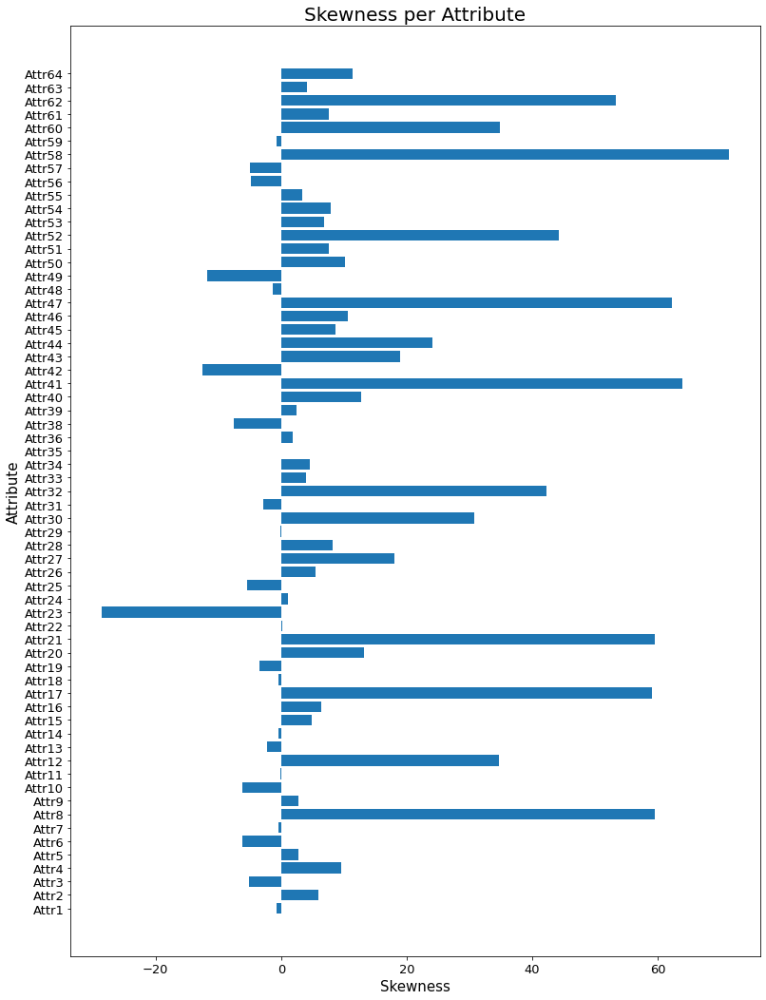

In [63]:
# Describe the Skewness of the DF without NaN and deleted outliers
labels_  = df_inp_del.loc[:, df_inp_del.columns != 'class'].columns.values
skew_    = df_inp_del.loc[:, df_inp_del.columns != 'class'].skew().values

# Graphically
plt.figure(figsize=(13,18))
plt.barh(labels_,skew_)
plt.plot(-1,0,"--")
plt.title('Skewness per Attribute', fontsize=20)
plt.ylabel('Attribute', fontsize=15)
plt.xlabel('Skewness', fontsize=15)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.show()

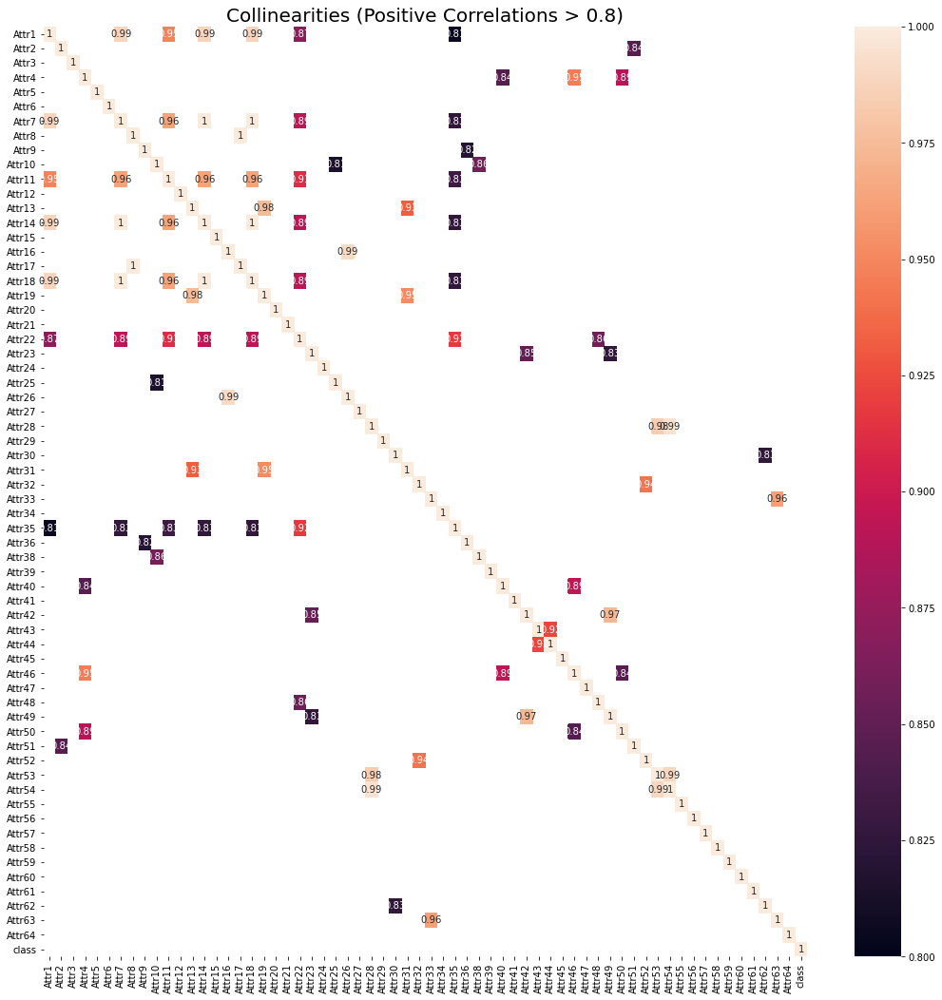

In [40]:
# Big Picture: Positive Correlations
corr_mat = df_inp_del.corr()

plt.figure(figsize=(18,18))
ax = sns.heatmap(corr_mat[corr_mat>0.8], vmin = 0.8, vmax = 1, annot=True)
ax.set_title('Collinearities (Positive Correlations > 0.8)', fontsize=20)
plt.show()

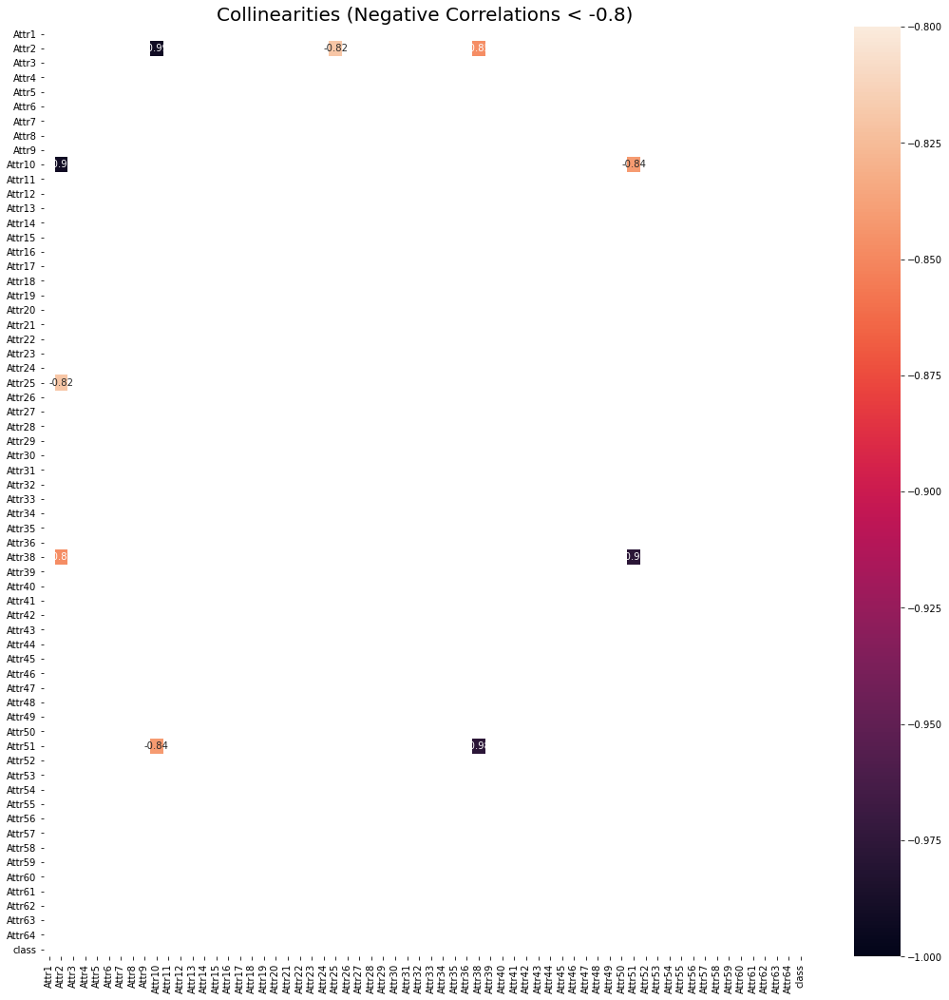

In [41]:
# Big Picture: Negative Correlations
corr_mat = df_inp_del.corr()

plt.figure(figsize=(18,18))
ax = sns.heatmap(corr_mat[corr_mat<-0.8], vmin = -1, vmax = -0.8, annot=True)
ax.set_title('Collinearities (Negative Correlations < -0.8)', fontsize=20)
plt.show()

In [42]:
# Let's check for groups of collinearity with negative correlation
threshold = 0.8

cumulative_ = []
countclus = 0

for name in df_inp_del.columns:
    
    if name not in cumulative_:
            clus = pd.DataFrame()
            clus["Corr"] = corr_mat[name][abs(corr_mat[name])>threshold].round(decimals=3)
            clus["Count"] = df_inp_del.count()[clus.index]
            
            if not clus.empty:
                countclus = countclus+1
                cumulative_.extend(clus.index)
                print(clus,"\n")

print("Number of Variables to Use: ", countclus)

         Corr  Count
Attr1   1.000   9938
Attr7   0.988   9938
Attr11  0.948   9938
Attr14  0.988   9938
Attr18  0.988   9938
Attr22  0.871   9938
Attr35  0.805   9938 

         Corr  Count
Attr2   1.000   9938
Attr10 -0.992   9938
Attr25 -0.820   9938
Attr38 -0.847   9938
Attr51  0.845   9938 

       Corr  Count
Attr3   1.0   9938 

         Corr  Count
Attr4   1.000   9938
Attr40  0.845   9938
Attr46  0.946   9938
Attr50  0.889   9938 

       Corr  Count
Attr5   1.0   9938 

       Corr  Count
Attr6   1.0   9938 

         Corr  Count
Attr8   1.000   9938
Attr17  0.999   9938 

        Corr  Count
Attr9   1.00   9938
Attr36  0.82   9938 

        Corr  Count
Attr12   1.0   9938 

         Corr  Count
Attr13  1.000   9938
Attr19  0.975   9938
Attr31  0.933   9938 

        Corr  Count
Attr15   1.0   9938 

         Corr  Count
Attr16  1.000   9938
Attr26  0.991   9938 

        Corr  Count
Attr20   1.0   9938 

        Corr  Count
Attr21   1.0   9938 

         Corr  Count
Attr23  

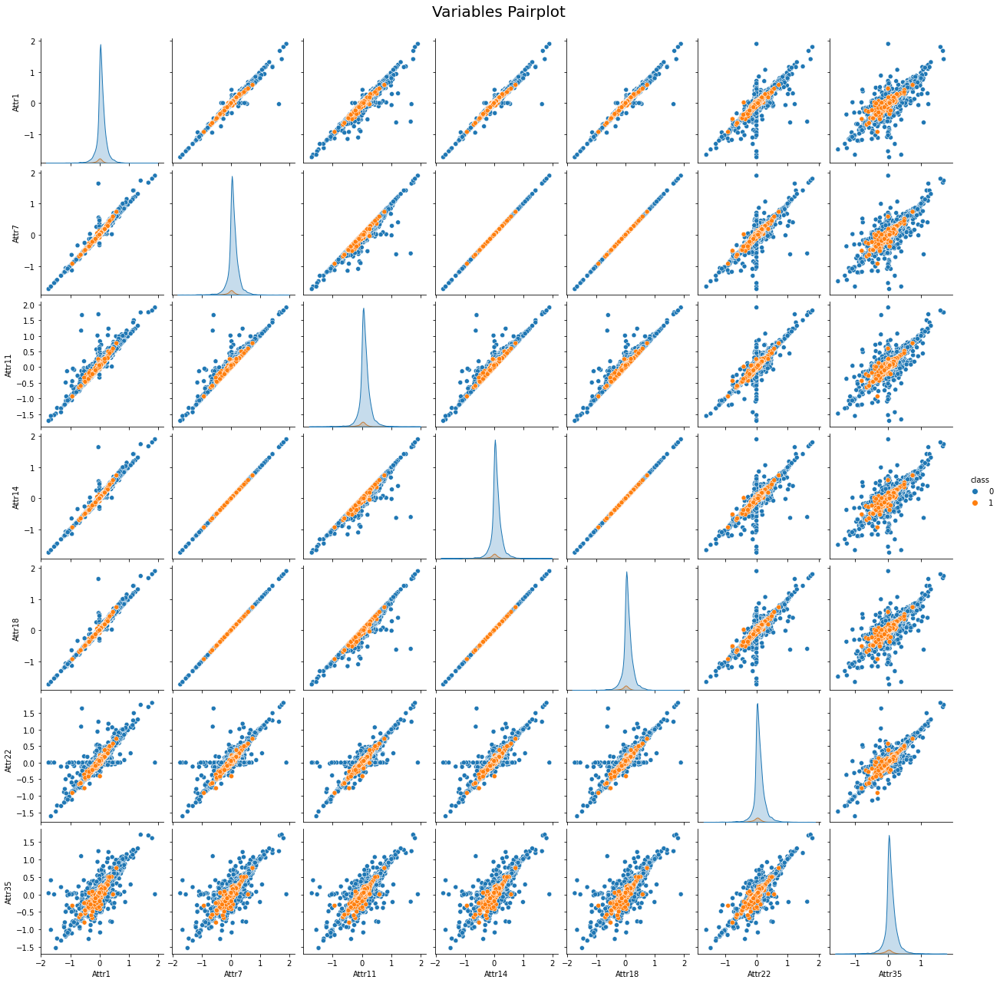

In [43]:
# Pairplot for Variables-Group
list_ = ["Attr1","Attr7","Attr11","Attr14","Attr18","Attr22","Attr35","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

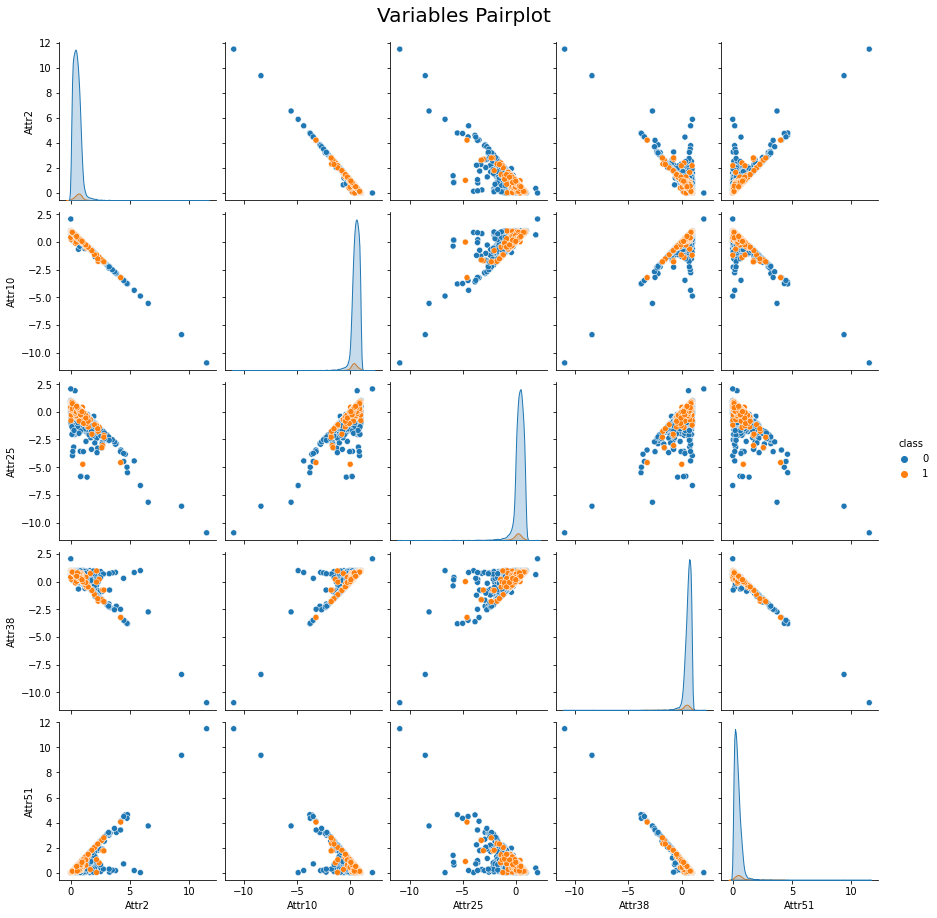

In [44]:
# Pairplot for Variables-Group
list_ = ["Attr2","Attr10","Attr25","Attr38","Attr51","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

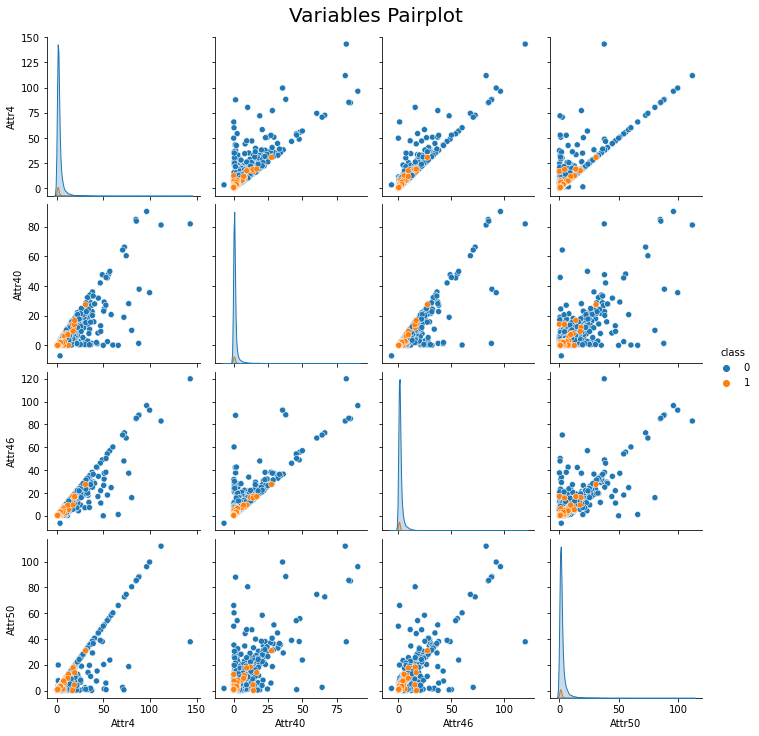

In [45]:
# Pairplot for Variables-Group
list_ = ["Attr4","Attr40", "Attr46","Attr50","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

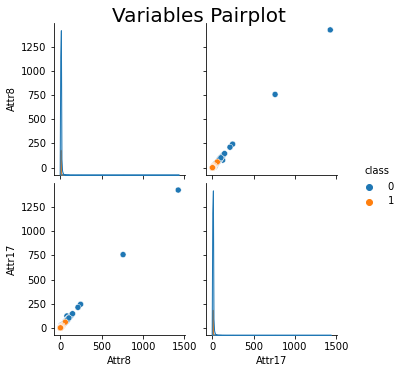

In [46]:
# Pairplot for Variables-Group
list_ = ["Attr8","Attr17","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

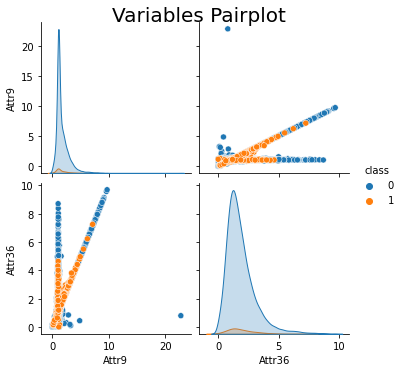

In [47]:
# Pairplot for Variables-Group
list_ = ["Attr9","Attr36","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

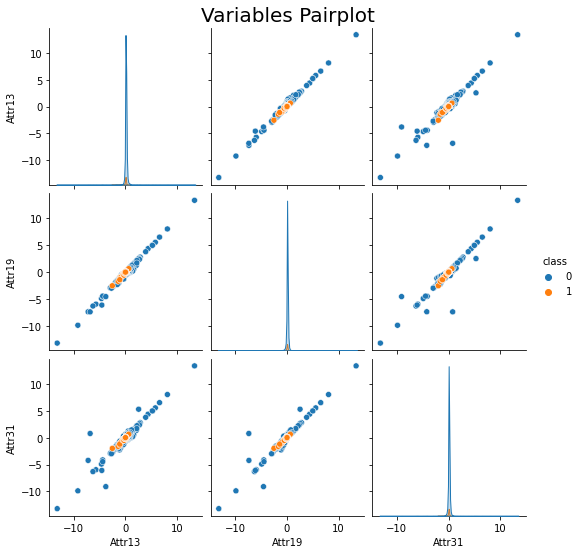

In [48]:
# Pairplot for Variables-Group
list_ = ["Attr13","Attr19","Attr31","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

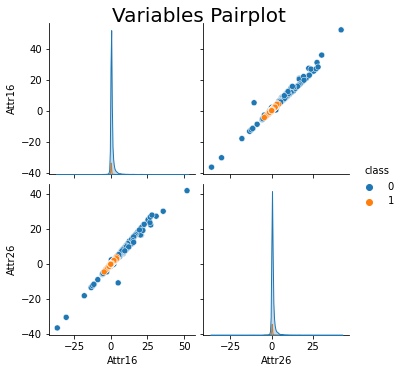

In [49]:
# Pairplot for Variables-Group
list_ = ["Attr16","Attr26","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

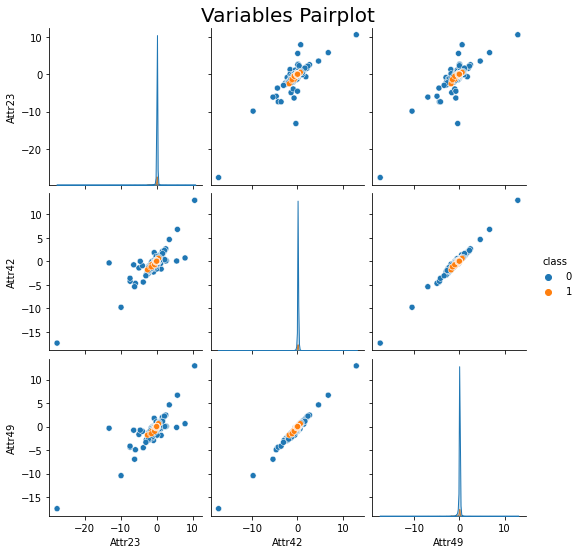

In [50]:
# Pairplot for Variables-Group
list_ = ["Attr23","Attr42","Attr49","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

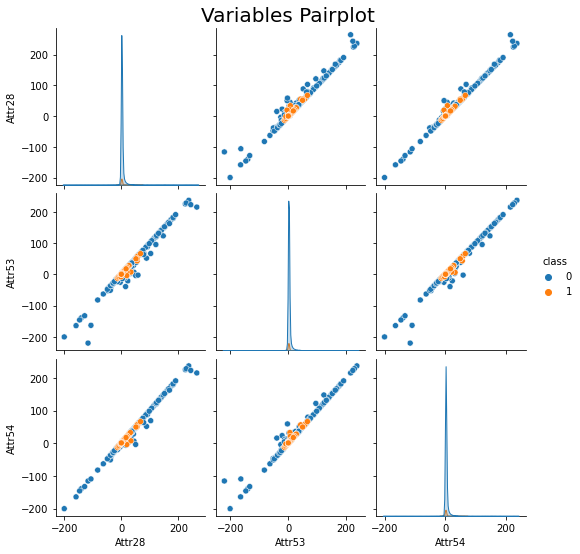

In [51]:
# Pairplot for Variables-Group
list_ = ["Attr28","Attr53","Attr54","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

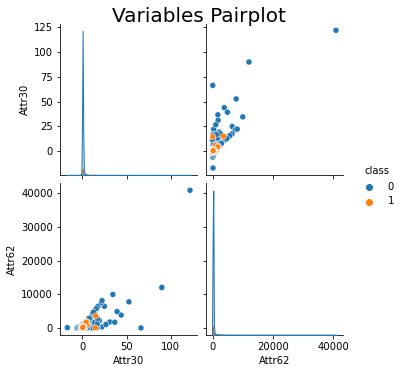

In [52]:
# Pairplot for Variables-Group
list_ = ["Attr30","Attr62","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

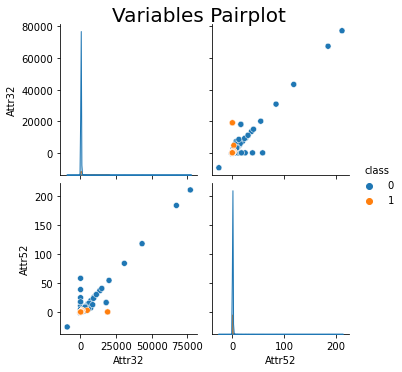

In [53]:
# Pairplot for Variables-Group
list_ = ["Attr32","Attr52","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

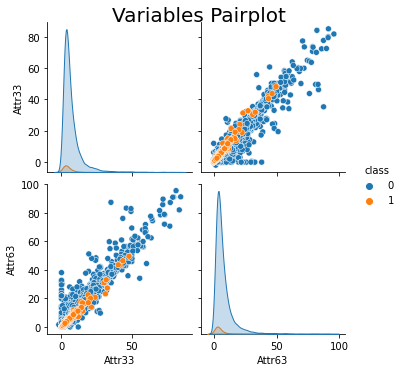

In [54]:
# Pairplot for Variables-Group
list_ = ["Attr33","Attr63","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

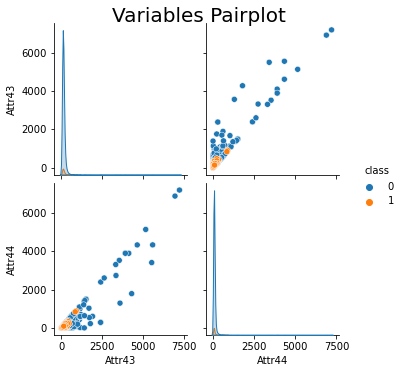

In [55]:
# Pairplot for Variables-Group
list_ = ["Attr43","Attr44","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

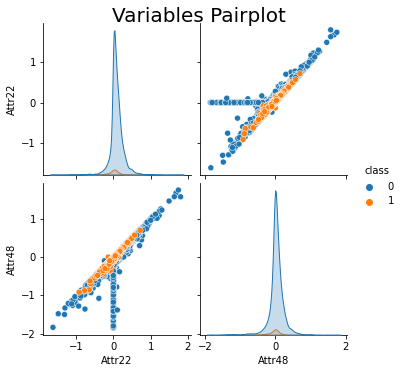

In [56]:
# Pairplot for Variables-Group
list_ = ["Attr22","Attr48","class"]
df_inp_del_ = df_inp_del[list_]
ax = sns.pairplot(df_inp_del_,hue="class")
ax.fig.suptitle("Variables Pairplot", y = 1.02, fontsize = 20)
plt.show()

In [57]:
# It seems that the variables that (to my perspective) can be dismissed at this point has greater correlation.
threshold = 0.95

cumulative_ = []
countclus = 0

for name in df_inp_del.columns:
    
    if name not in cumulative_:
            clus = pd.DataFrame()
            clus["Corr"] = corr_mat[name][abs(corr_mat[name])>threshold].round(decimals=3)
            clus["Count"] = df_inp_del.count()[clus.index]
            
            if not clus.empty:
                countclus = countclus+1
                cumulative_.extend(clus.index)
                print(clus,"\n")

print("Number of Variables to Use: ", countclus)

         Corr  Count
Attr1   1.000   9938
Attr7   0.988   9938
Attr14  0.988   9938
Attr18  0.988   9938 

         Corr  Count
Attr2   1.000   9938
Attr10 -0.992   9938 

       Corr  Count
Attr3   1.0   9938 

       Corr  Count
Attr4   1.0   9938 

       Corr  Count
Attr5   1.0   9938 

       Corr  Count
Attr6   1.0   9938 

         Corr  Count
Attr8   1.000   9938
Attr17  0.999   9938 

       Corr  Count
Attr9   1.0   9938 

         Corr  Count
Attr7   0.963   9938
Attr11  1.000   9938
Attr14  0.963   9938
Attr18  0.963   9938 

        Corr  Count
Attr12   1.0   9938 

         Corr  Count
Attr13  1.000   9938
Attr19  0.975   9938 

        Corr  Count
Attr15   1.0   9938 

         Corr  Count
Attr16  1.000   9938
Attr26  0.991   9938 

        Corr  Count
Attr20   1.0   9938 

        Corr  Count
Attr21   1.0   9938 

        Corr  Count
Attr22   1.0   9938 

        Corr  Count
Attr23   1.0   9938 

        Corr  Count
Attr24   1.0   9938 

        Corr  Count
Attr25   1.0

### Variable Filtering

Manual inspection correlates a filter of **correlation < 0.95** between variables to be considered to apply for variable selection. 

The pre-selected variables are 50, and are the following: 
'Attr1',
'Attr2',
'Attr3',
'Attr4',
'Attr5',
'Attr6',
'Attr8',
'Attr9',
'Attr11',
'Attr12',
'Attr13',
'Attr15',
'Attr16',
'Attr20',
'Attr21',
'Attr22',
'Attr23',
'Attr24',
'Attr25',
'Attr27',
'Attr28',
'Attr29',
'Attr30',
'Attr32',
'Attr33',
'Attr34',
'Attr35',
'Attr36',
'Attr38',
'Attr39',
'Attr40',
'Attr41',
'Attr42',
'Attr43',
'Attr44',
'Attr45',
'Attr46',
'Attr47',
'Attr48',
'Attr50',
'Attr52',
'Attr55',
'Attr56',
'Attr57',
'Attr58',
'Attr59',
'Attr60',
'Attr61',
'Attr62',
'Attr64'

## Resampling, Data Normalisation and Feature Selection

In [58]:
# Define the set from which the resampling will take place
df_model = df_inp_del[['Attr1','Attr2','Attr3','Attr4','Attr5','Attr6','Attr8','Attr9','Attr11','Attr12','Attr13','Attr15','Attr16','Attr20','Attr21','Attr22','Attr23','Attr24','Attr25','Attr27','Attr28','Attr29','Attr30','Attr32','Attr33','Attr34','Attr35','Attr36','Attr38','Attr39','Attr40','Attr41','Attr42','Attr43','Attr44','Attr45','Attr46','Attr47','Attr48','Attr50', 'Attr52','Attr55','Attr56','Attr57','Attr58','Attr59','Attr60','Attr61','Attr62','Attr64','class']]
df_model.shape

(9938, 51)

In [59]:
df_model.describe()

,Attr1,Attr2,Attr3,Attr4,Attr5,Attr6,Attr8,Attr9,Attr11,Attr12,Attr13,Attr15,Attr16,Attr20,Attr21,Attr22,Attr23,Attr24,Attr25,Attr27,Attr28,Attr29,Attr30,Attr32,Attr33,Attr34,Attr35,Attr36,Attr38,Attr39,Attr40,Attr41,Attr42,Attr43,Attr44,Attr45,Attr46,Attr47,Attr48,Attr50,Attr52,Attr55,Attr56,Attr57,Attr58,Attr59,Attr60,Attr61,Attr62,Attr64,class
count,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000,9938.000000
mean,0.051721,0.510425,0.193666,2.964666,5.332374,0.006772,3.196858,1.651534,0.084318,0.498444,0.074043,1791.097905,0.625376,51.643095,1.215190,0.076121,0.015372,0.207847,0.327735,211.428812,2.426630,3.936588,0.425985,159.831665,6.689907,3.851144,0.071817,1.856267,0.569844,0.029831,0.988860,0.771490,0.034610,125.840547,74.175064,2.728836,2.133688,73.878915,0.015937,2.357337,0.431350,4616.621827,0.067890,0.124146,1.009392,0.353160,72.611105,10.227685,120.096268,15.873833,0.041055
std,0.186420,0.402415,0.382751,5.415650,2944.208987,0.407978,17.814133,1.155704,0.198151,2.660517,0.366696,14552.220185,1.878445,81.566827,10.198439,0.185181,0.441821,0.421151,0.500025,3313.505379,12.548291,0.785045,2.360521,1294.458665,7.211151,6.234329,0.189754,1.223392,0.357873,0.261116,3.450347,23.152905,0.325393,207.963578,176.848905,82.947254,4.556066,716.790051,0.225450,4.652179,3.480000,18513.903830,0.247140,1.593064,4.131832,4.498856,1017.096445,15.087438,521.061471,58.500101,0.198426
min,-1.742400,0.000000,-10.579000,0.002522,-96364.000000,-8.138100,-1.025300,0.000000,-1.706900,-36.400000,-13.206000,-269420.000000,-36.400000,0.000000,0.000000,-1.619000,-27.662000,-4.274800,-10.925000,-41119.000000,-199.870000,1.406000,-17.031000,-9295.600000,-1.921900,-13.050000,-1.528600,0.000000,-10.925000,-9.751200,-7.081900,-388.700000,-17.338000,0.000000,0.000000,-3978.000000,-6.469200,-3.706700,-1.845800,0.002409,-25.467000,-161010.000000,-5.267500,-51.613000,-1.328100,-142.790000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.001380,0.258115,0.020262,1.047775,-50.989250,0.000000,0.442960,1.012800,0.011161,0.008661,0.022255,217.952500,0.064503,15.164500,0.814118,0.000000,0.001035,0.021167,0.145577,0.042929,0.039231,3.424675,0.079299,46.043250,2.830825,0.381575,0.002943,1.050425,0.433573,0.002372,0.053899,0.025882,0.000000,66.977500,35.211000,0.016229,0.609538,16.176750,-0.046836,0.758898,0.125910,27.819750,0.006436,0.007483,0.876823,0.000000,5.672075,4.515700,41.905750,2.054400,0.000000
50%,0.043540,0.462565,0.197830,1.604750,1.464000,0.000000,1.116800,1.197800,0.069044,0.157990,0.067419,833.895000,0.236020,35.052000,0.955370,0.055845,0.027919,0.168500,0.384330,1.071050,0.475665,3.948600,0.219370,77.497500,4.666550,2.055500,0.054590,1.579400,0.629555,0.035159,0.192825,0.079722,0.036152,99.811000,54.650500,0.282670,1.055200,37.695000,0.010785,1.229600,0.212150,945.560000,0.052602,0.106460,0.952665,0.006029,10.015500,6.657700,71.061500,4.057050,0.000000
75%,0.123045,0.683647,0.412377,2.897200,54.274000,0.076429,2.787075,2.027475,0.160100,0.557343,0.132200,2220.350000,0.627860,64.244750,1.088275,0.145720,0.075823,0.367270,0.613873,4.235575,1.484050,4.449525,0.422868,127.580000,7.913700,4.650025,0.145403,2.343250,0.784285,0.091324,0.716265,0.194815,0.091600,140.977500,80.544250,0.875665,2.003450,70.034500,0.100373,2.272400,0.348665,4448.675000,0.128925,0.267328,0.995160,0.255720,19.572000,10.343250,117.762500,9.009075,0.000000
max,1.900200,11.497000,1.054600,143.200000,90895.000000,3.300500,1424.300000,22

A way to asses the information that provide each predictor and the proper model, is to iterate between models analyzing their performances.

Models considered for classifcation are:
1. SVMs
2. Random Forests
3. Logistic Regression
4. KNN

In [60]:
# Libraries
